In [ ]:
!pip install -q kaggle

In [ ]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle (1).json


{'kaggle.json': b'{"username":"mehranehmgh","key":"c2c1365e6432393d8c5dfbe309c0236c"}'}

In [ ]:
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

mkdir: cannot create directory ‘/root/.kaggle’: File exists


In [ ]:
!kaggle datasets download -d mrmorj/dataset-of-songs-in-spotify

dataset-of-songs-in-spotify.zip: Skipping, found more recently modified local copy (use --force to force download)


In [ ]:
!unzip '/content/dataset-of-songs-in-spotify.zip' -d '/content/'

Archive:  /content/dataset-of-songs-in-spotify.zip
replace /content/genres_v2.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: n
replace /content/playlists.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: N


In [1]:
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.cluster import DBSCAN
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import normalize
from sklearn.decomposition import PCA
from sklearn import preprocessing

from sklearn.metrics import silhouette_samples, silhouette_score

from mpl_toolkits import mplot3d

# Find song names and create new CSV

In [ ]:
df = pd.read_csv('/content/genres_v2.csv')
df

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (19) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,id,uri,track_href,analysis_url,duration_ms,time_signature,genre,song_name,Unnamed: 0,title
0,0.831,0.814,2,-7.364,1,0.4200,0.059800,0.013400,0.0556,0.3890,156.985,audio_features,2Vc6NJ9PW9gD9q343XFRKx,spotify:track:2Vc6NJ9PW9gD9q343XFRKx,https://api.spotify.com/v1/tracks/2Vc6NJ9PW9gD...,https://api.spotify.com/v1/audio-analysis/2Vc6...,124539,4,Dark Trap,Mercury: Retrograde,NaN,NaN
1,0.719,0.493,8,-7.230,1,0.0794,0.401000,0.000000,0.1180,0.1240,115.080,audio_features,7pgJBLVz5VmnL7uGHmRj6p,spotify:track:7pgJBLVz5VmnL7uGHmRj6p,https://api.spotify.com/v1/tracks/7pgJBLVz5Vmn...,https://api.spotify.com/v1/audio-analysis/7pgJ...,224427,4,Dark Trap,Pathology,NaN,NaN
2,0.850,0.893,5,-4.783,1,0.0623,0.013800,0.000004,0.3720,0.0391,218.050,audio_features,0vSWgAlfpye0WCGeNmuNhy,spotify:track:0vSWgAlfpye0WCGeNmuNhy,https://api.spotify.com/v1/tracks/0vSWgAlfpye0...,https://api.spotify.com/v1/audio-analysis/0vSW...,98821,4,Dark Trap,Symbiote,NaN,NaN
3,0.476,0.781,0,-4.710,1,0.1030,0.023700,0.000000,0.1140,0.1750,186.948,audio_features,0VSXnJqQkwuH2ei1nOQ1nu,spotify:track:0VSXnJqQkwuH2ei1nOQ1nu,https://api.spotify.com/v1/tracks/0VSXnJqQkwuH...,https://api.spotify.com/v1/audio-analysis/0VSX...,123661,3,Dark Trap,ProductOfDrugs (Prod. The Virus and Antidote),NaN,NaN
4,0.798,0.624,2,-7.668,1,0.2930,0.217000,0.000000,0.1660,0.5910,147.988,audio_features,4jCeguq9rMTlbMmPHuO7S3,spotify:track:4jCeguq9rMTlbMmPHuO7S3,https://api.spotify.com/v1/tracks/4jCeguq9rMTl...,https://api.spotify.com/v1/audio-analysis/4jCe...,123298,4,Dark Trap,Venom,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42300,0.528,0.693,4,-5.148,1,0.0304,0.031500,0.000345,0.1210,0.3940,150.013,audio_features,46bXU7Sgj7104ZoXxzz9tM,spotify:track:46bXU7Sgj7104ZoXxzz9tM,https://api.spotify.com/v1/tracks/46bXU7Sgj710...,https://api.spotify.com/v1/audio-analysis/46bX...,269208,4,hardstyle,NaN,20995.0,Euphoric Hardstyle
42301,0.517,0.768,0,-7.922,0,0.0479,0.022500,0.000018,0.2050,0.3830,149.928,audio_features,0he2ViGMUO3ajKTxLOfWVT,spotify:track:0he2ViGMUO3ajKTxLOfWVT,https://api.spotify.com/v1/tracks/0he2ViGMUO3a...,https://api.spotify.com/v1/audio-analysis/0he2...,210112,4,hardstyle,NaN,20996.0,Greatest Hardstyle Playlist
42302,0.361,0.821,8,-3.102,1,0.0505,0.026000,0.000242,0.3850,0.1240,154.935,audio_features,72DAt9Lbpy9EUS29OzQLob,spotify:track:72DAt9Lbpy9EUS29OzQLob,https://api.spotify.com/v1/tracks/72DAt9Lbpy9E...,https://api.spotify.com/v1/audio-analysis/72DA...,234823,4,hardstyle,NaN,20997.0,Best of Hardstyle 2020
42303,0.477,0.921,6,-4.777,0,0.0392,0.000551,0.029600,0.0575,0.4880,150.042,audio_features,6HXgExFVuE1c3cq9QjFCcU,spotify:track:6HXgExFVuE1c3cq9QjFCcU,https://api.spotify.com/v1/tracks/6HXgExFVuE1c...,https://api.spotify.com/v1/audio-analysis/6HXg...,323200,4,hardstyle,NaN,20998.0,Euphoric Hardstyle


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42305 entries, 0 to 42304
Data columns (total 22 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   danceability      42305 non-null  float64
 1   energy            42305 non-null  float64
 2   key               42305 non-null  int64  
 3   loudness          42305 non-null  float64
 4   mode              42305 non-null  int64  
 5   speechiness       42305 non-null  float64
 6   acousticness      42305 non-null  float64
 7   instrumentalness  42305 non-null  float64
 8   liveness          42305 non-null  float64
 9   valence           42305 non-null  float64
 10  tempo             42305 non-null  float64
 11  type              42305 non-null  object 
 12  id                42305 non-null  object 
 13  uri               42305 non-null  object 
 14  track_href        42305 non-null  object 
 15  analysis_url      42305 non-null  object 
 16  duration_ms       42305 non-null  int64 

In [ ]:
df.isna().sum()

danceability            0
energy                  0
key                     0
loudness                0
mode                    0
speechiness             0
acousticness            0
instrumentalness        0
liveness                0
valence                 0
tempo                   0
type                    0
id                      0
uri                     0
track_href              0
analysis_url            0
duration_ms             0
time_signature          0
genre                   0
song_name           20786
Unnamed: 0          21525
title               21525
dtype: int64

In [ ]:
df.drop(['Unnamed: 0'],axis=1, inplace=True)

In [ ]:
df.genre.unique()

array(['Dark Trap', 'Underground Rap', 'Trap Metal', 'Emo', 'Rap', 'RnB',
       'Pop', 'Hiphop', 'techhouse', 'techno', 'trance', 'psytrance',
       'trap', 'dnb', 'hardstyle'], dtype=object)

In [ ]:
!pip install urllib3 --upgrade 
!pip install requests --upgrade 
!pip install spotipy --upgrade

In [ ]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from spotipy.oauth2 import SpotifyOAuth

In [ ]:
cid = '77ced2b31c3249878dec55df6d63f37f'
secret = 'b1fb99925755441bb56f6ec9a85acc4b'
client_credentials_manager = SpotifyClientCredentials(client_id=cid, client_secret=secret)

In [ ]:
sp = spotipy.Spotify(client_credentials_manager=client_credentials_manager)

In [ ]:
track = 'spotify:track:2Vc6NJ9PW9gD9q343XFRKx'
track = sp.track(track)

print(track["name"])

Mercury: Retrograde


In [ ]:
pd.DataFrame(track['artists'])

,external_urls,href,id,name,type,uri
0,{'spotify': 'https://open.spotify.com/artist/3...,https://api.spotify.com/v1/artists/3uL4UpqShC4...,3uL4UpqShC4p2x1dJutoRW,Ghostemane,artist,spotify:artist:3uL4UpqShC4p2x1dJutoRW


In [ ]:

len(df)

42305

In [ ]:
#list_1 = df[df['song_name'].isnull()].index.tolist()

In [ ]:
#song_nan = df.loc[list_1]

In [ ]:
# song_nan['index'] = list(range(len(song_nan)))
# song_nan.set_index(song_nan['index'], inplace = True)

In [ ]:
#song_nan

In [ ]:
track[0] = 'spotify:track:'+df.id.loc[500]
track[0] = sp.track(track[0])
track[0]['name']

'LEAVE'

In [ ]:
track[1] = 'spotify:track:'+df.id.loc[600]
track[1] = sp.track(track[1])
track[1]['name']

'Light Yagami'

In [ ]:
indices = df['song_name'].isna()
indices = indices[indices].index

In [ ]:
indices[0]

18597

In [ ]:
df.song_name[indices[0]]

nan

In [ ]:
df.id.loc[indices[1]]

'13q8un4Xjs3IOfdem4jgVe'

In [ ]:
for i in range(len(indices)):
    track[indices[i]]='spotify:track:'+df.id.loc[indices[i]]
    track[indices[i]] = sp.track(track[indices[i]])
    df.song_name.loc[indices[i]] = track[indices[i]]['name']

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


In [ ]:
df.song_name

0                                  Mercury: Retrograde
1                                            Pathology
2                                             Symbiote
3        ProductOfDrugs (Prod. The Virus and Antidote)
4                                                Venom
                             ...                      
42300                                        Wonderful
42301                                  Together As One
42302                         Diving - Hardstyle Remix
42303                       What I Need - Original Mix
42304                                             GTFO
Name: song_name, Length: 42305, dtype: object

In [ ]:
#df.to_csv (r'/content/drive/MyDrive/spotify_data/spotify_dataframe.csv', index = False, header=True)

# Work with the new CSV 

In [ ]:
df=pd.read_csv("/content/drive/MyDrive/spotify_data/spotify_dataframe.csv")

In [ ]:
df

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,id,uri,track_href,analysis_url,duration_ms,time_signature,genre,song_name,title
0,0.831,0.814,2,-7.364,1,0.4200,0.059800,0.013400,0.0556,0.3890,156.985,audio_features,2Vc6NJ9PW9gD9q343XFRKx,spotify:track:2Vc6NJ9PW9gD9q343XFRKx,https://api.spotify.com/v1/tracks/2Vc6NJ9PW9gD...,https://api.spotify.com/v1/audio-analysis/2Vc6...,124539,4,Dark Trap,Mercury: Retrograde,NaN
1,0.719,0.493,8,-7.230,1,0.0794,0.401000,0.000000,0.1180,0.1240,115.080,audio_features,7pgJBLVz5VmnL7uGHmRj6p,spotify:track:7pgJBLVz5VmnL7uGHmRj6p,https://api.spotify.com/v1/tracks/7pgJBLVz5Vmn...,https://api.spotify.com/v1/audio-analysis/7pgJ...,224427,4,Dark Trap,Pathology,NaN
2,0.850,0.893,5,-4.783,1,0.0623,0.013800,0.000004,0.3720,0.0391,218.050,audio_features,0vSWgAlfpye0WCGeNmuNhy,spotify:track:0vSWgAlfpye0WCGeNmuNhy,https://api.spotify.com/v1/tracks/0vSWgAlfpye0...,https://api.spotify.com/v1/audio-analysis/0vSW...,98821,4,Dark Trap,Symbiote,NaN
3,0.476,0.781,0,-4.710,1,0.1030,0.023700,0.000000,0.1140,0.1750,186.948,audio_features,0VSXnJqQkwuH2ei1nOQ1nu,spotify:track:0VSXnJqQkwuH2ei1nOQ1nu,https://api.spotify.com/v1/tracks/0VSXnJqQkwuH...,https://api.spotify.com/v1/audio-analysis/0VSX...,123661,3,Dark Trap,ProductOfDrugs (Prod. The Virus and Antidote),NaN
4,0.798,0.624,2,-7.668,1,0.2930,0.217000,0.000000,0.1660,0.5910,147.988,audio_features,4jCeguq9rMTlbMmPHuO7S3,spotify:track:4jCeguq9rMTlbMmPHuO7S3,https://api.spotify.com/v1/tracks/4jCeguq9rMTl...,https://api.spotify.com/v1/audio-analysis/4jCe...,123298,4,Dark Trap,Venom,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42300,0.528,0.693,4,-5.148,1,0.0304,0.031500,0.000345,0.1210,0.3940,150.013,audio_features,46bXU7Sgj7104ZoXxzz9tM,spotify:track:46bXU7Sgj7104ZoXxzz9tM,https://api.spotify.com/v1/tracks/46bXU7Sgj710...,https://api.spotify.com/v1/audio-analysis/46bX...,269208,4,hardstyle,Wonderful,Euphoric Hardstyle
42301,0.517,0.768,0,-7.922,0,0.0479,0.022500,0.000018,0.2050,0.3830,149.928,audio_features,0he2ViGMUO3ajKTxLOfWVT,spotify:track:0he2ViGMUO3ajKTxLOfWVT,https://api.spotify.com/v1/tracks/0he2ViGMUO3a...,https://api.spotify.com/v1/audio-analysis/0he2...,210112,4,hardstyle,Together As One,Greatest Hardstyle Playlist
42302,0.361,0.821,8,-3.102,1,0.0505,0.026000,0.000242,0.3850,0.1240,154.935,audio_features,72DAt9Lbpy9EUS29OzQLob,spotify:track:72DAt9Lbpy9EUS29OzQLob,https://api.spotify.com/v1/tracks/72DAt9Lbpy9E...,https://api.spotify.com/v1/audio-analysis/72DA...,234823,4,hardstyle,Diving - Hardstyle Remix,Best of Hardstyle 2020
42303,0.477,0.921,6,-4.777,0,0.0392,0.000551,0.029600,0.0575,0.4880,150.042,audio_features,6HXgExFVuE1c3cq9QjFCcU,spotify:track:6HXgExFVuE1c3cq9QjFCcU,https://api.spotify.com/v1/tracks/6HXgExFVuE1c...,https://api.spotify.com/v1/audio-analysis/6HXg...,323200,4,hardstyle,What I Need - Original Mix,Euphoric Hardstyle


In [ ]:
new_df = df.drop(['type', 'id', 'uri', 'track_href','analysis_url', 'title','song_name'], axis=1)

In [ ]:
new_df

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,genre
0,0.831,0.814,2,-7.364,1,0.4200,0.059800,0.013400,0.0556,0.3890,156.985,124539,4,Dark Trap
1,0.719,0.493,8,-7.230,1,0.0794,0.401000,0.000000,0.1180,0.1240,115.080,224427,4,Dark Trap
2,0.850,0.893,5,-4.783,1,0.0623,0.013800,0.000004,0.3720,0.0391,218.050,98821,4,Dark Trap
3,0.476,0.781,0,-4.710,1,0.1030,0.023700,0.000000,0.1140,0.1750,186.948,123661,3,Dark Trap
4,0.798,0.624,2,-7.668,1,0.2930,0.217000,0.000000,0.1660,0.5910,147.988,123298,4,Dark Trap
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42300,0.528,0.693,4,-5.148,1,0.0304,0.031500,0.000345,0.1210,0.3940,150.013,269208,4,hardstyle
42301,0.517,0.768,0,-7.922,0,0.0479,0.022500,0.000018,0.2050,0.3830,149.928,210112,4,hardstyle
42302,0.361,0.821,8,-3.102,1,0.0505,0.026000,0.000242,0.3850,0.1240,154.935,234823,4,hardstyle
42303,0.477,0.921,6,-4.777,0,0.0392,0.000551,0.029600,0.0575,0.4880,150.042,323200,4,hardstyle


# **Preprocessing**

In [ ]:
new_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42305 entries, 0 to 42304
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   danceability      42305 non-null  float64
 1   energy            42305 non-null  float64
 2   key               42305 non-null  int64  
 3   loudness          42305 non-null  float64
 4   mode              42305 non-null  int64  
 5   speechiness       42305 non-null  float64
 6   acousticness      42305 non-null  float64
 7   instrumentalness  42305 non-null  float64
 8   liveness          42305 non-null  float64
 9   valence           42305 non-null  float64
 10  tempo             42305 non-null  float64
 11  duration_ms       42305 non-null  int64  
 12  time_signature    42305 non-null  int64  
 13  genre             42305 non-null  object 
dtypes: float64(9), int64(4), object(1)
memory usage: 4.5+ MB


In [ ]:
##Label Encoding

le = preprocessing.LabelEncoder()
new_df['genre']= le.fit_transform(new_df['genre'])

In [ ]:
new_df.genre.unique()

array([ 0,  7,  6,  1,  4,  5,  3,  2, 11, 12, 13, 10, 14,  8,  9])

In [ ]:
pip install -U pandas-profiling

In [ ]:
import pandas_profiling

In [ ]:
new_df.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
df.genre.value_counts()

Underground Rap    5875
Dark Trap          4578
Hiphop             3028
trance             2999
trap               2987
techhouse          2975
dnb                2966
psytrance          2961
techno             2956
hardstyle          2936
RnB                2099
Trap Metal         1956
Rap                1848
Emo                1680
Pop                 461
Name: genre, dtype: int64

In [ ]:
new_df.genre.value_counts()

7     5875
0     4578
2     3028
13    2999
14    2987
11    2975
8     2966
10    2961
12    2956
9     2936
5     2099
6     1956
4     1848
1     1680
3      461
Name: genre, dtype: int64

## **Scaling**

In [ ]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(new_df)

#X_normalized = normalize(new_df)

X_scaled = pd.DataFrame(X_scaled,columns=new_df.columns)

In [ ]:
X_scaled

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,genre
0,1.223608,0.280079,-0.919298,-0.305514,0.905517,2.246552,-0.212853,-0.727231,-0.902637,0.136790,0.398876,-1.226992,0.102184,-1.668945
1,0.508480,-1.466185,0.717318,-0.259954,0.905517,-0.453057,1.784518,-0.763370,-0.547231,-0.999586,-1.358564,-0.256796,0.102184,-1.668945
2,1.344924,0.709845,-0.100990,0.572039,0.905517,-0.588592,-0.482135,-0.763359,0.899456,-1.363655,2.959861,-1.476787,0.102184,-1.668945
3,-1.043093,0.100557,-1.464837,0.596860,0.905517,-0.266002,-0.424181,-0.763370,-0.570013,-0.780887,1.655485,-1.235520,-3.624453,-1.668945
4,1.012900,-0.753535,-0.919298,-0.408876,0.905517,1.239945,0.707390,-0.763370,-0.273841,1.003008,0.021554,-1.239046,0.102184,-1.668945
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42300,-0.711069,-0.378170,-0.373759,0.447937,0.905517,-0.841432,-0.378520,-0.762440,-0.530144,0.158231,0.106480,0.178154,0.102184,0.389962
42301,-0.781305,0.029836,-1.464837,-0.495237,-1.104341,-0.702727,-0.431205,-0.763321,-0.051712,0.111061,0.102915,-0.395836,0.102184,0.389962
42302,-1.777377,0.318160,0.717318,1.143588,0.905517,-0.682119,-0.410717,-0.762718,0.973499,-0.999586,0.312902,-0.155822,0.102184,0.389962
42303,-1.036708,0.862167,0.171779,0.574079,-1.104341,-0.771683,-0.559694,-0.683540,-0.891815,0.561323,0.107696,0.702570,0.102184,0.389962


In [ ]:
X_scaled.describe()

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,genre
count,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04,4.230500e+04
mean,-1.810330e-14,8.677396e-15,2.251731e-15,-1.203335e-15,-1.823734e-15,8.517343e-16,1.695740e-15,1.251657e-14,7.280360e-15,1.169688e-15,2.719331e-17,2.162692e-15,6.606420e-15,-4.427275e-14
std,1.000012e+00,1.000012e+00,1.000012e+00,1.000012e+00,1.000012e+00,1.000012e+00,1.000012e+00,1.000012e+00,1.000012e+00,1.000012e+00,1.000012e+00,1.000012e+00,1.000012e+00,1.000012e+00
min,-3.666720e+00,-4.146821e+00,-1.464837e+00,-9.143273e+00,-1.104341e+00,-9.024629e-01,-5.629132e-01,-7.633702e-01,-1.158370e+00,-1.451135e+00,-3.753807e+00,-2.187971e+00,-1.107773e+01,-1.668945e+00
25%,-7.366096e-01,-7.100147e-01,-1.192067e+00,-5.764987e-01,-1.104341e+00,-6.932155e-01,-5.527921e-01,-7.633702e-01,-6.520299e-01,-8.409223e-01,-7.357325e-01,-6.898627e-01,1.021841e-01,-7.538755e-01
50%,4.236930e-02,2.202383e-01,1.717792e-01,7.869155e-02,9.055171e-01,-4.839682e-01,-4.669145e-01,-7.473502e-01,-4.504050e-01,-1.505203e-01,-1.048910e-01,-2.535619e-01,1.021841e-01,-6.757306e-02
75%,8.085781e-01,8.730474e-01,9.900871e-01,6.638407e-01,9.055171e-01,4.473412e-01,6.345413e-02,1.183841e+00,4.551981e-01,7.071219e-01,5.867197e-01,4.882368e-01,1.021841e-01,8.474968e-01
max,2.226064e+00,1.291933e+00,1.535626e+00,3.268622e+00,9.055171e-01,6.415647e+00,5.220792e+00,1.903931e+00,4.407956e+00,2.705428e+00,3.053804e+00,6.431708e+00,3.828822e+00,1.533799e+00


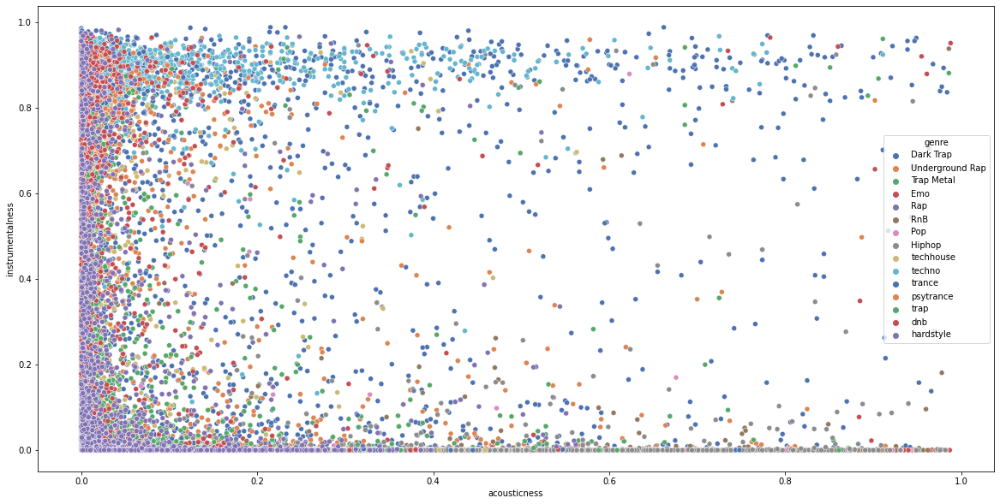

In [ ]:
plt.figure(figsize=(20,10))
sns.scatterplot(x = 'acousticness',y = 'instrumentalness', data = df, hue = 'genre',palette='deep')
plt.show()

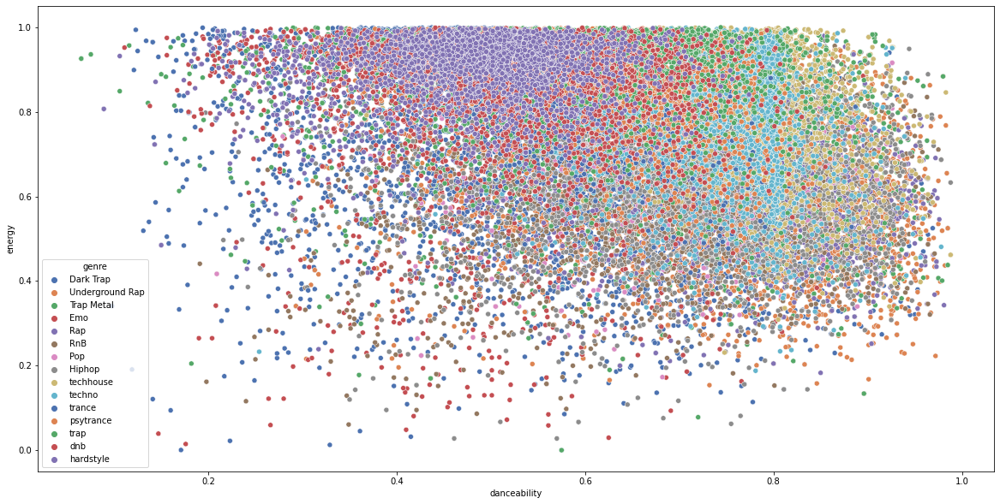

In [ ]:
plt.figure(figsize=(20,10))
sns.scatterplot(x = 'danceability',y = 'energy', data = df, hue = 'genre',palette='deep')
plt.show()

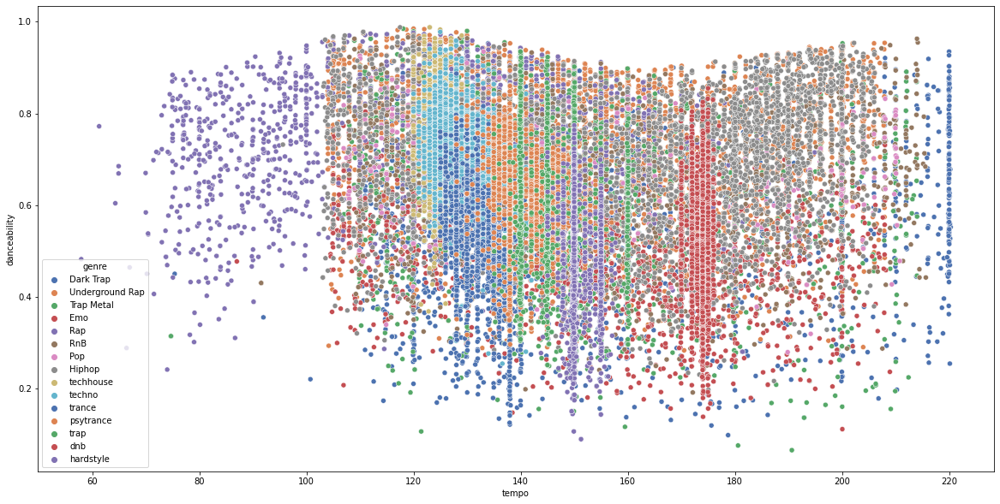

In [ ]:
plt.figure(figsize=(20,10))
sns.scatterplot(x = 'tempo',y = 'danceability', data = df, hue = 'genre',palette='deep')
plt.show()

In [ ]:
new_df

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,genre,kmeans_label,tsne-2d-one,tsne-2d-two
0,0.831,0.814,2,-7.364,1,0.4200,0.059800,0.013400,0.0556,0.3890,156.985,124539,4,0,7,10.501968,-2.411661
1,0.719,0.493,8,-7.230,1,0.0794,0.401000,0.000000,0.1180,0.1240,115.080,224427,4,0,4,-1.671839,0.146965
2,0.850,0.893,5,-4.783,1,0.0623,0.013800,0.000004,0.3720,0.0391,218.050,98821,4,0,8,8.481277,7.861226
3,0.476,0.781,0,-4.710,1,0.1030,0.023700,0.000000,0.1140,0.1750,186.948,123661,3,0,13,9.683084,-1.745458
4,0.798,0.624,2,-7.668,1,0.2930,0.217000,0.000000,0.1660,0.5910,147.988,123298,4,0,7,9.574396,-0.977356
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42300,0.528,0.693,4,-5.148,1,0.0304,0.031500,0.000345,0.1210,0.3940,150.013,269208,4,9,10,-6.903639,-1.311834
42301,0.517,0.768,0,-7.922,0,0.0479,0.022500,0.000018,0.2050,0.3830,149.928,210112,4,9,11,-3.128555,-0.609643
42302,0.361,0.821,8,-3.102,1,0.0505,0.026000,0.000242,0.3850,0.1240,154.935,234823,4,9,10,-4.574578,0.743850
42303,0.477,0.921,6,-4.777,0,0.0392,0.000551,0.029600,0.0575,0.4880,150.042,323200,4,9,11,-1.630416,-10.507124


# Cluster model with Scaled data

## DBSCAN

Text(0.5, 1.0, 'DBSCAN')

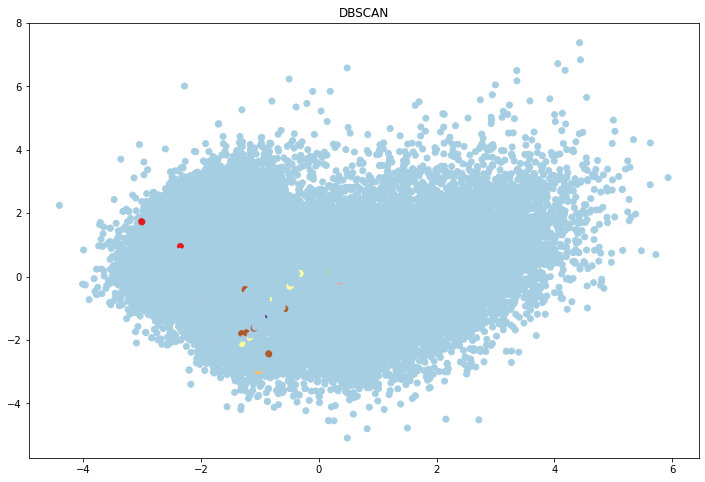

In [ ]:
db = DBSCAN(eps=0.003, min_samples=5).fit(X_scaled)
db_label = db.labels_

pca = PCA(n_components = 2)
X = pca.fit_transform(X_scaled)

y_pred = db.fit_predict(X_scaled)

fig = plt.figure(figsize=(12,8))
plt.scatter(X[:,0], X[:,1],c=y_pred, cmap='Paired')
plt.title("DBSCAN")

In [ ]:
np.unique(db_label)

array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
       16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32,
       33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49,
       50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66,
       67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82])

In [ ]:
# cluster_map = pd.DataFrame()
# cluster_map['data_index'] = new_df.index.values
# cluster_map['cluster_db'] = db_label
# cluster_map['genre']=new_df.genre
# cluster_map

## KMEANS

In [ ]:
range_n_clusters = [2, 3, 5, 6, 7, 8, 9, 10, 11, 15, 16 , 17, 20, 22, 25, 30, 40, 50, 55, 60]
for n_clusters in range_n_clusters:
  clusterer = KMeans(n_clusters=n_clusters, max_iter=50)
  cluster_labels = clusterer.fit_predict(X_scaled)

  silhouette_avg = silhouette_score(X_scaled, cluster_labels)
  print("for n_clusters =", n_clusters, "The average silhouette_score is :", silhouette_avg)

for n_clusters = 2 The average silhouette_score is : 0.16043571241292157
for n_clusters = 3 The average silhouette_score is : 0.13552255628072668
for n_clusters = 5 The average silhouette_score is : 0.12634052595255607
for n_clusters = 6 The average silhouette_score is : 0.12983739618394258
for n_clusters = 7 The average silhouette_score is : 0.12015604335854863
for n_clusters = 8 The average silhouette_score is : 0.12588033518045566
for n_clusters = 9 The average silhouette_score is : 0.10634913108604022
for n_clusters = 10 The average silhouette_score is : 0.11790071418919765
for n_clusters = 11 The average silhouette_score is : 0.10854884011237056
for n_clusters = 15 The average silhouette_score is : 0.11044716297898623
for n_clusters = 16 The average silhouette_score is : 0.11134708190069469
for n_clusters = 17 The average silhouette_score is : 0.11010893924974881
for n_clusters = 20 The average silhouette_score is : 0.11045637284445951
for n_clusters = 22 The average silhouette_sc

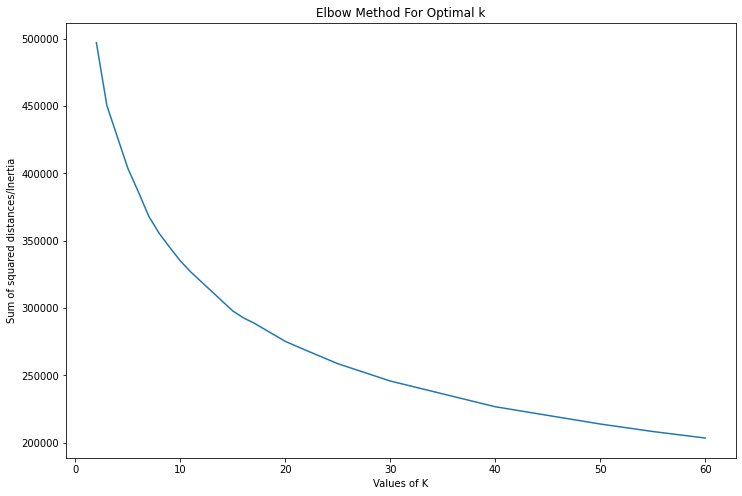

In [ ]:
Sum_of_squared_distances = []

K = [2, 3, 5, 6, 7, 8, 9, 10, 11, 15, 16 , 17, 20, 22, 25, 30, 40, 50, 55, 60]
for num_clusters in K :
  kmeans = KMeans(n_clusters=num_clusters, random_state = 0, max_iter=50)
  kmeans.fit_predict(X_scaled)
  Sum_of_squared_distances.append(kmeans.inertia_)

fig = plt.figure(figsize=(12,8))
plt.plot(K,Sum_of_squared_distances)
plt.xlabel('Values of K') 
plt.ylabel('Sum of squared distances/Inertia') 
plt.title('Elbow Method For Optimal k')
plt.show()

In [ ]:
kmn = KMeans(n_clusters=15, random_state = 0).fit(X_scaled)
pca = PCA(n_components = 2)
X = pca.fit_transform(X_scaled)
y_pred = kmn.fit_predict(X_scaled)
label = kmn.labels_
# plt.scatter(X[:,0], X[:,1],c=y_pred, cmap='Paired')
# plt.title("kmeans")

Text(0.5, 1.0, 'kmeans')

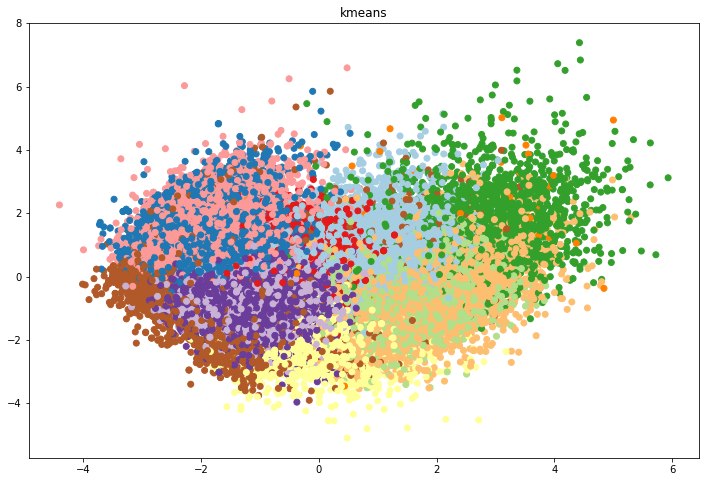

In [ ]:
fig = plt.figure(figsize=(12,8))
plt.scatter(X[:,0], X[:,1],c=y_pred, cmap='Paired')
plt.title("kmeans")

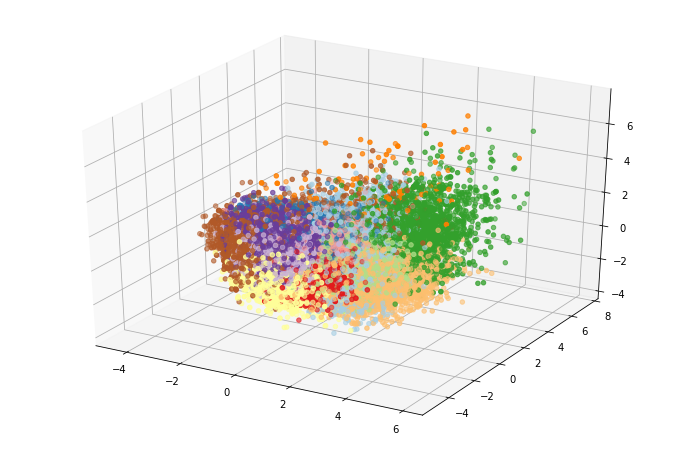

In [ ]:
fig = plt.figure(figsize=(12,8))
ax = plt.axes(projection='3d')

kmn = KMeans(n_clusters=15,random_state = 0).fit(X_scaled)
pca = PCA(n_components = 3)
X = pca.fit_transform(X_scaled)
y_pred = kmn.fit_predict(X_scaled)
label = kmn.labels_

ax.scatter3D(X[:,0],X[:,1],X[:,2], c=y_pred, cmap='Paired');
# plt.title("kmeans")

In [ ]:
new_df['kmeans_label'] = label

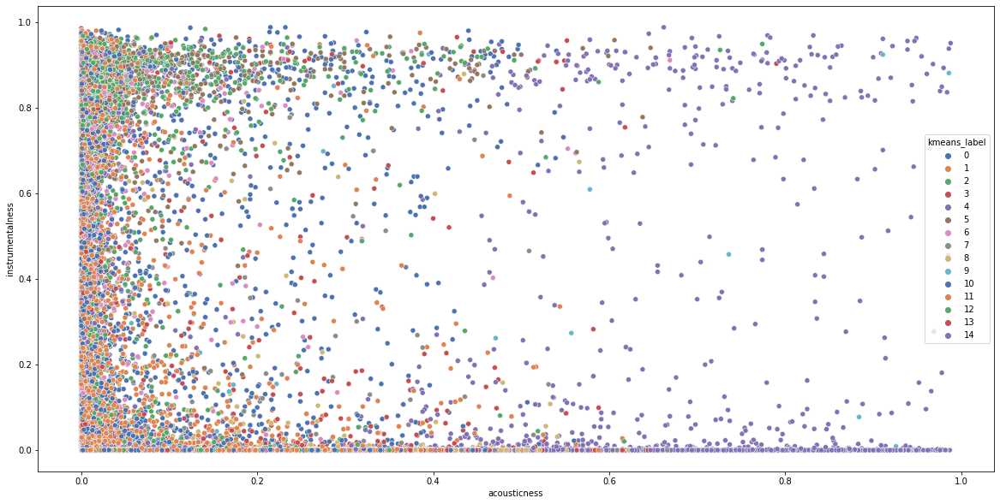

In [ ]:
plt.figure(figsize=(20,10))
sns.scatterplot(x = 'acousticness',y = 'instrumentalness', data = new_df, hue = 'kmeans_label',palette='deep')
plt.show()

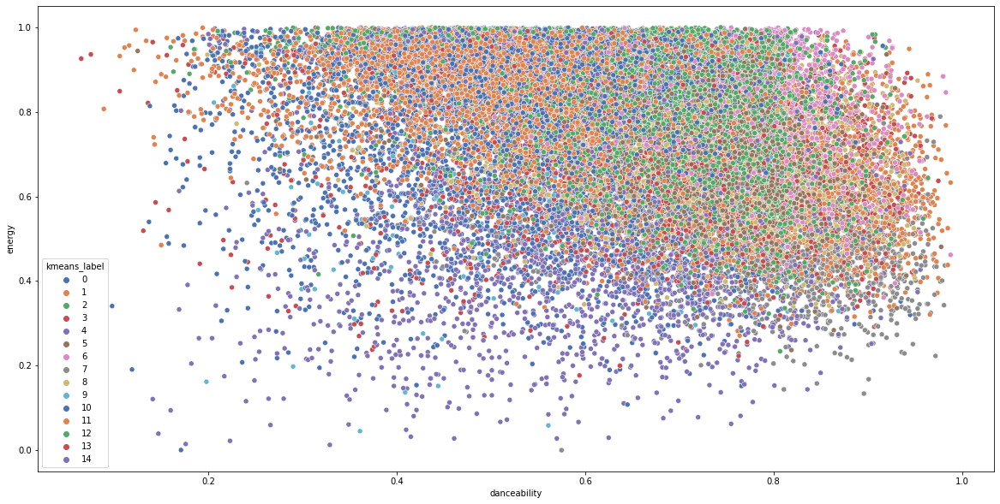

In [ ]:
plt.figure(figsize=(20,10))
sns.scatterplot(x = 'danceability',y = 'energy', data = new_df, hue = 'kmeans_label',palette='deep')
plt.show()

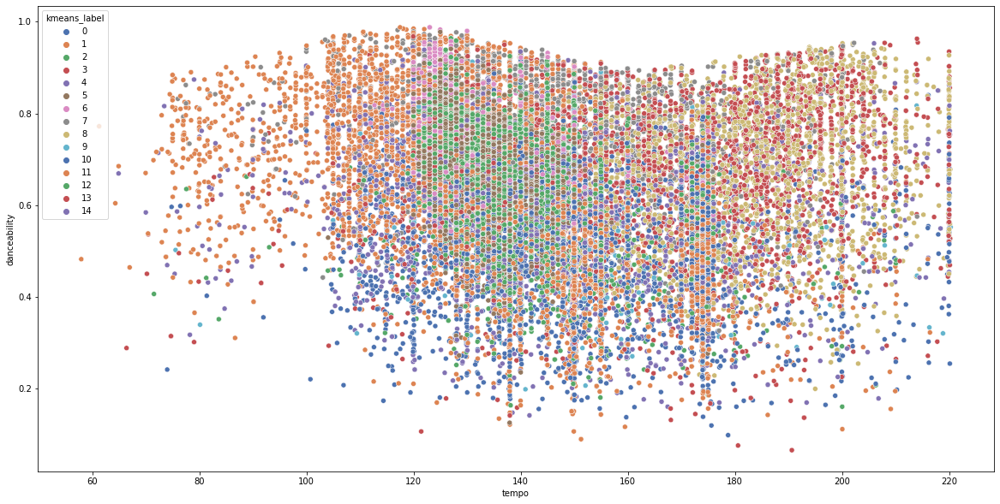

In [ ]:
plt.figure(figsize=(20,10))
sns.scatterplot(x = 'tempo',y = 'danceability', data = new_df, hue = 'kmeans_label',palette='deep')
plt.show()

In [ ]:
mask = new_df['kmeans_label'] == 5
new_df[mask].genre.value_counts()

12    1482
10    1290
13     451
11     372
8       84
9       42
14      18
0       11
7        3
4        3
1        1
6        1
2        1
Name: genre, dtype: int64

In [ ]:
mask = new_df['kmeans_label'] == 12
new_df[mask].genre.value_counts()

14    1056
6      278
7      200
9      173
8       84
0       60
2       29
13      27
4       23
5       13
1        9
11       5
10       2
3        2
Name: genre, dtype: int64

In [ ]:
new_df

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,genre,kmeans_label
0,0.831,0.814,2,-7.364,1,0.4200,0.059800,0.013400,0.0556,0.3890,156.985,124539,4,0,7
1,0.719,0.493,8,-7.230,1,0.0794,0.401000,0.000000,0.1180,0.1240,115.080,224427,4,0,4
2,0.850,0.893,5,-4.783,1,0.0623,0.013800,0.000004,0.3720,0.0391,218.050,98821,4,0,8
3,0.476,0.781,0,-4.710,1,0.1030,0.023700,0.000000,0.1140,0.1750,186.948,123661,3,0,13
4,0.798,0.624,2,-7.668,1,0.2930,0.217000,0.000000,0.1660,0.5910,147.988,123298,4,0,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42300,0.528,0.693,4,-5.148,1,0.0304,0.031500,0.000345,0.1210,0.3940,150.013,269208,4,9,10
42301,0.517,0.768,0,-7.922,0,0.0479,0.022500,0.000018,0.2050,0.3830,149.928,210112,4,9,11
42302,0.361,0.821,8,-3.102,1,0.0505,0.026000,0.000242,0.3850,0.1240,154.935,234823,4,9,10
42303,0.477,0.921,6,-4.777,0,0.0392,0.000551,0.029600,0.0575,0.4880,150.042,323200,4,9,11


In [ ]:
tsne = TSNE()
X_embedded = tsne.fit_transform(X_scaled)

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


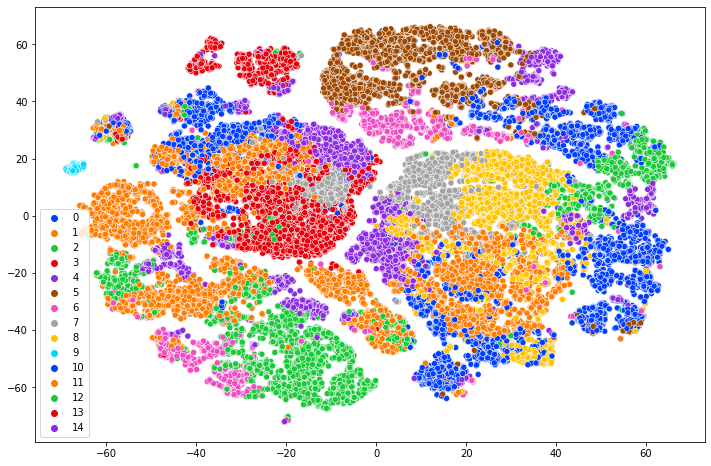

In [ ]:
palette = sns.color_palette("bright", 15)

fig = plt.figure(figsize=(12,8))
sns.scatterplot(X_embedded[:,0], X_embedded[:,1], hue=y_pred, legend='full', palette=palette)

##  Hierarchichal Clustering

In [ ]:
hc = AgglomerativeClustering(n_clusters=10, affinity='euclidean', linkage='single')
cluster = hc.fit(X_scaled)

In [ ]:
pca = PCA(n_components = 2)
X = pca.fit_transform(X_scaled)
y_pred = cluster.fit_predict(X_scaled)
label = cluster.labels_
label

array([0, 0, 0, ..., 0, 0, 0])

In [ ]:
np.unique(label)

array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

Text(0.5, 1.0, 'Hierarchical Clustering')

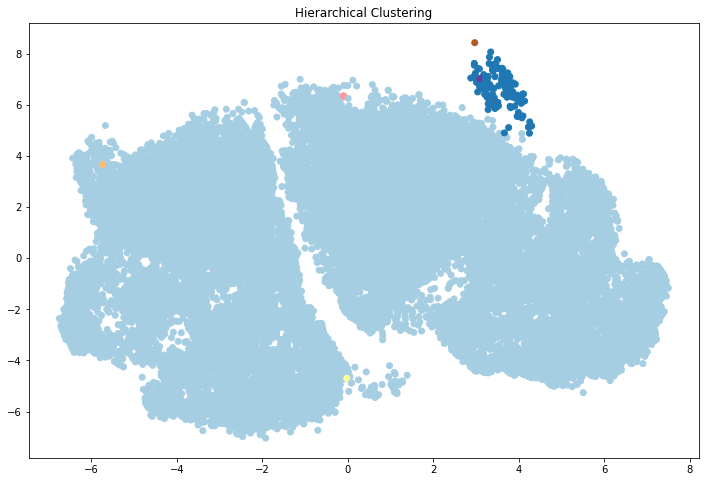

In [ ]:
fig = plt.figure(figsize=(12,8))
plt.scatter(X[:,0], X[:,1],c=y_pred, cmap='Paired')
plt.title("Hierarchical Clustering")

In [ ]:
# import pickle
# pickle.dump(clustering, open("model.pkl", "wb"))

In [ ]:
##ONE_HOT
df=pd.read_csv("/content/drive/MyDrive/spotify_data/spotify_dataframe.csv")
new_df = df.drop(['type', 'id', 'uri', 'track_href','analysis_url', 'title','song_name'], axis=1)

In [ ]:
new_df

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,genre
0,0.831,0.814,2,-7.364,1,0.4200,0.059800,0.013400,0.0556,0.3890,156.985,124539,4,Dark Trap
1,0.719,0.493,8,-7.230,1,0.0794,0.401000,0.000000,0.1180,0.1240,115.080,224427,4,Dark Trap
2,0.850,0.893,5,-4.783,1,0.0623,0.013800,0.000004,0.3720,0.0391,218.050,98821,4,Dark Trap
3,0.476,0.781,0,-4.710,1,0.1030,0.023700,0.000000,0.1140,0.1750,186.948,123661,3,Dark Trap
4,0.798,0.624,2,-7.668,1,0.2930,0.217000,0.000000,0.1660,0.5910,147.988,123298,4,Dark Trap
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42300,0.528,0.693,4,-5.148,1,0.0304,0.031500,0.000345,0.1210,0.3940,150.013,269208,4,hardstyle
42301,0.517,0.768,0,-7.922,0,0.0479,0.022500,0.000018,0.2050,0.3830,149.928,210112,4,hardstyle
42302,0.361,0.821,8,-3.102,1,0.0505,0.026000,0.000242,0.3850,0.1240,154.935,234823,4,hardstyle
42303,0.477,0.921,6,-4.777,0,0.0392,0.000551,0.029600,0.0575,0.4880,150.042,323200,4,hardstyle


In [ ]:
encoded_data = pd.get_dummies(new_df, columns = ['genre'])

In [ ]:
encoded_data

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,genre_Dark Trap,genre_Emo,genre_Hiphop,genre_Pop,genre_Rap,genre_RnB,genre_Trap Metal,genre_Underground Rap,genre_dnb,genre_hardstyle,genre_psytrance,genre_techhouse,genre_techno,genre_trance,genre_trap
0,0.831,0.814,2,-7.364,1,0.4200,0.059800,0.013400,0.0556,0.3890,156.985,124539,4,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0.719,0.493,8,-7.230,1,0.0794,0.401000,0.000000,0.1180,0.1240,115.080,224427,4,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0.850,0.893,5,-4.783,1,0.0623,0.013800,0.000004,0.3720,0.0391,218.050,98821,4,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0.476,0.781,0,-4.710,1,0.1030,0.023700,0.000000,0.1140,0.1750,186.948,123661,3,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0.798,0.624,2,-7.668,1,0.2930,0.217000,0.000000,0.1660,0.5910,147.988,123298,4,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42300,0.528,0.693,4,-5.148,1,0.0304,0.031500,0.000345,0.1210,0.3940,150.013,269208,4,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
42301,0.517,0.768,0,-7.922,0,0.0479,0.022500,0.000018,0.2050,0.3830,149.928,210112,4,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
42302,0.361,0.821,8,-3.102,1,0.0505,0.026000,0.000242,0.3850,0.1240,154.935,234823,4,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
42303,0.477,0.921,6,-4.777,0,0.0392,0.000551,0.029600,0.0575,0.4880,150.042,323200,4,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0


In [ ]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(encoded_data)

#X_normalized = normalize(new_df)

X_scaled = pd.DataFrame(X_scaled,columns=encoded_data.columns)

In [ ]:
X_scaled

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,genre_Dark Trap,genre_Emo,genre_Hiphop,genre_Pop,genre_Rap,genre_RnB,genre_Trap Metal,genre_Underground Rap,genre_dnb,genre_hardstyle,genre_psytrance,genre_techhouse,genre_techno,genre_trance,genre_trap
0,1.223608,0.280079,-0.919298,-0.305514,0.905517,2.246552,-0.212853,-0.727231,-0.902637,0.136790,0.398876,-1.226992,0.102184,2.870703,-0.203356,-0.277657,-0.104962,-0.213724,-0.228487,-0.220175,-0.401582,-0.274583,-0.273087,-0.274334,-0.275031,-0.274085,-0.276222,-0.275627
1,0.508480,-1.466185,0.717318,-0.259954,0.905517,-0.453057,1.784518,-0.763370,-0.547231,-0.999586,-1.358564,-0.256796,0.102184,2.870703,-0.203356,-0.277657,-0.104962,-0.213724,-0.228487,-0.220175,-0.401582,-0.274583,-0.273087,-0.274334,-0.275031,-0.274085,-0.276222,-0.275627
2,1.344924,0.709845,-0.100990,0.572039,0.905517,-0.588592,-0.482135,-0.763359,0.899456,-1.363655,2.959861,-1.476787,0.102184,2.870703,-0.203356,-0.277657,-0.104962,-0.213724,-0.228487,-0.220175,-0.401582,-0.274583,-0.273087,-0.274334,-0.275031,-0.274085,-0.276222,-0.275627
3,-1.043093,0.100557,-1.464837,0.596860,0.905517,-0.266002,-0.424181,-0.763370,-0.570013,-0.780887,1.655485,-1.235520,-3.624453,2.870703,-0.203356,-0.277657,-0.104962,-0.213724,-0.228487,-0.220175,-0.401582,-0.274583,-0.273087,-0.274334,-0.275031,-0.274085,-0.276222,-0.275627
4,1.012900,-0.753535,-0.919298,-0.408876,0.905517,1.239945,0.707390,-0.763370,-0.273841,1.003008,0.021554,-1.239046,0.102184,2.870703,-0.203356,-0.277657,-0.104962,-0.213724,-0.228487,-0.220175,-0.401582,-0.274583,-0.273087,-0.274334,-0.275031,-0.274085,-0.276222,-0.275627
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42300,-0.711069,-0.378170,-0.373759,0.447937,0.905517,-0.841432,-0.378520,-0.762440,-0.530144,0.158231,0.106480,0.178154,0.102184,-0.348347,-0.203356,-0.277657,-0.104962,-0.213724,-0.228487,-0.220175,-0.401582,-0.274583,3.661838,-0.274334,-0.275031,-0.274085,-0.276222,-0.275627
42301,-0.781305,0.029836,-1.464837,-0.495237,-1.104341,-0.702727,-0.431205,-0.763321,-0.051712,0.111061,0.102915,-0.395836,0.102184,-0.348347,-0.203356,-0.277657,-0.104962,-0.213724,-0.228487,-0.220175,-0.401582,-0.274583,3.661838,-0.274334,-0.275031,-0.274085,-0.276222,-0.275627
42302,-1.777377,0.318160,0.717318,1.143588,0.905517,-0.682119,-0.410717,-0.762718,0.973499,-0.999586,0.312902,-0.155822,0.102184,-0.348347,-0.203356,-0.277657,-0.104962,-0.213724,-0.228487,-0.220175,-0.401582,-0.274583,3.661838,-0.274334,-0.275031,-0.274085,-0.276222,-0.275627
42303,-1.036708,0.862167,0.171779,0.574079,-1.104341,-0.771683,-0.559694,-0.683540,-0.891815,0.561323,0.107696,0.702570,0.102184,-0.348347,-0.203356,-0.277657,-0.104962,-0.213724,-0.228487,-0.220175,-0.401582,-0.274583,3.661838,-0.274334,-0.275031,-0.274085,-0.276222,-0.275627


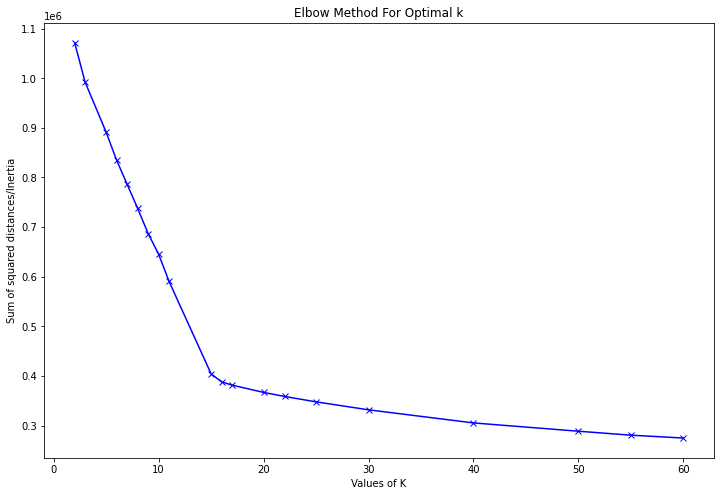

In [ ]:
Sum_of_squared_distances = []
K = [2, 3, 5, 6, 7, 8, 9, 10, 11, 15, 16 , 17, 20, 22, 25, 30, 40, 50, 55, 60]
for num_clusters in K :
  kmeans = KMeans(n_clusters=num_clusters, max_iter=50)
  kmeans.fit_predict(X_scaled)
  Sum_of_squared_distances.append(kmeans.inertia_)

fig = plt.figure(figsize=(12,8))
plt.plot(K,Sum_of_squared_distances,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Sum of squared distances/Inertia') 
plt.title('Elbow Method For Optimal k')
plt.show()

Text(0.5, 1.0, 'kmeans')

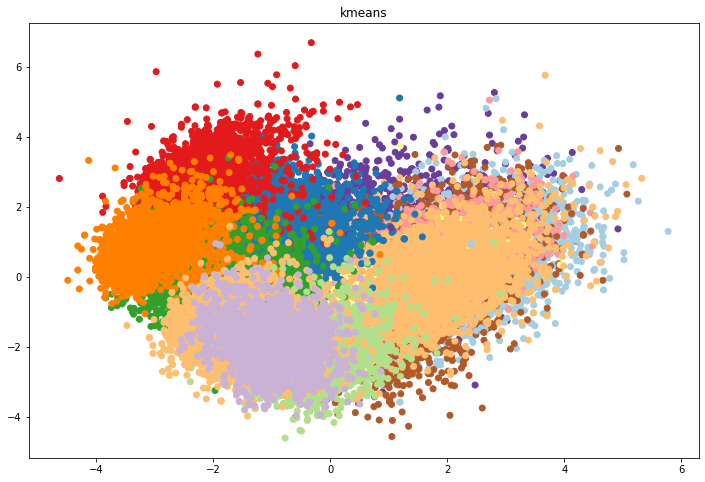

In [ ]:
kmn = KMeans(n_clusters=15,random_state = 0).fit(X_scaled)
pca = PCA(n_components = 2)
X = pca.fit_transform(X_scaled)
y_pred = kmn.fit_predict(X_scaled)
label = kmn.labels_

fig = plt.figure(figsize=(12,8))
plt.scatter(X[:,0], X[:,1],c=y_pred, cmap='Paired')
plt.title("kmeans")

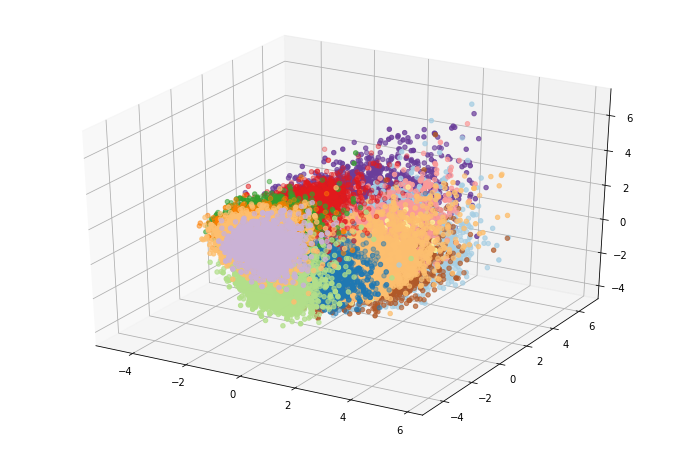

In [ ]:
fig = plt.figure(figsize=(12,8))
ax = plt.axes(projection='3d')

kmn = KMeans(n_clusters=15,random_state = 0).fit(X_scaled)
pca = PCA(n_components = 3)
X = pca.fit_transform(X_scaled)
y_pred = kmn.fit_predict(X_scaled)
label = kmn.labels_

ax.scatter3D(X[:,0],X[:,1],X[:,2], c=y_pred, cmap='Paired');
# plt.title("kmeans")

In [ ]:
tsne = TSNE()
X_embedded = tsne.fit_transform(X_scaled)

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


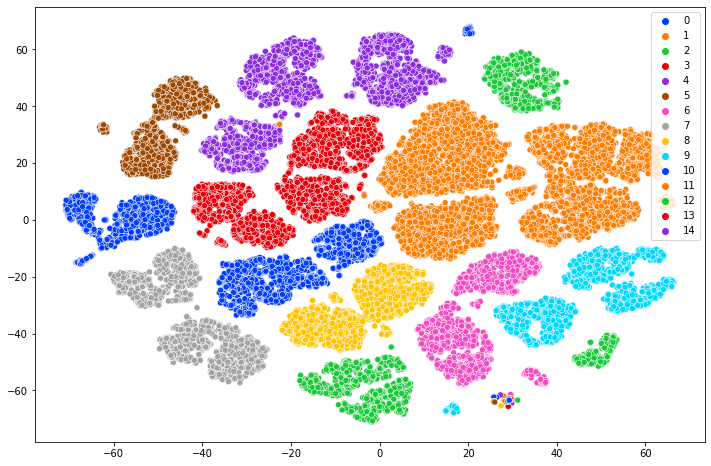

In [ ]:
palette = sns.color_palette("bright", 15)

fig = plt.figure(figsize=(12,8))
sns.scatterplot(X_embedded[:,0], X_embedded[:,1], hue=y_pred, legend='full', palette=palette)

In [ ]:
new_df['kmn_label'] = label

In [ ]:
mask = new_df['kmn_label'] == 5
new_df[mask].genre.value_counts()

RnB    2099
Name: genre, dtype: int64

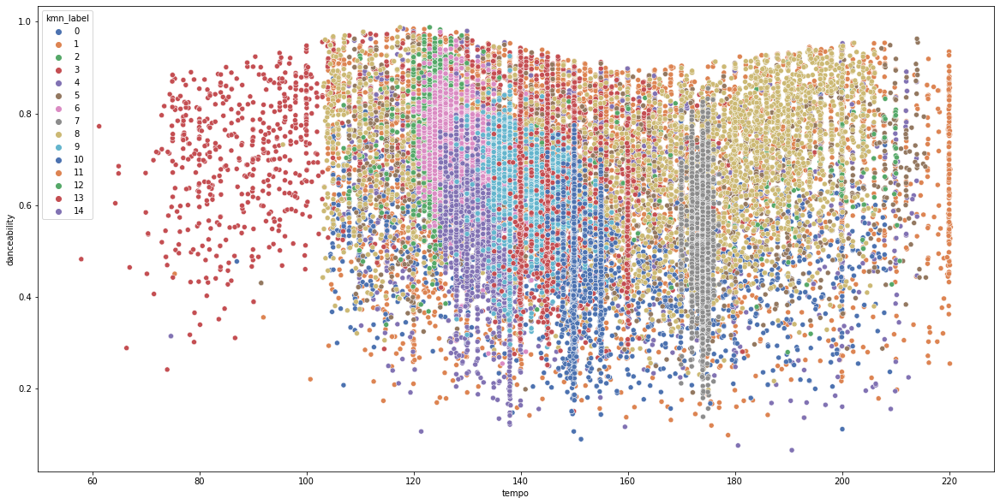

In [ ]:
plt.figure(figsize=(20,10))
sns.scatterplot(x = 'tempo',y = 'danceability', data = new_df, hue = 'kmn_label',palette='deep')
plt.show()

# Normalizing

In [ ]:
df=pd.read_csv("/content/drive/MyDrive/spotify_data/spotify_dataframe.csv")

In [ ]:
new_df = df.drop(['type', 'id', 'uri', 'track_href','analysis_url', 'title','song_name'], axis=1)

In [ ]:
le = preprocessing.LabelEncoder()
new_df['genre']= le.fit_transform(new_df['genre'])

In [ ]:
X_normalized = normalize(new_df)

X_normalized = pd.DataFrame(X_normalized,columns=new_df.columns)

In [ ]:
X_normalized

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,genre
0,0.000007,0.000007,0.000016,-0.000059,0.000008,3.372435e-06,4.801705e-07,1.075967e-07,4.464461e-07,3.123517e-06,0.001261,0.999999,0.000032,0.000000
1,0.000003,0.000002,0.000036,-0.000032,0.000004,3.537898e-07,1.786772e-06,0.000000e+00,5.257834e-07,5.525181e-07,0.000513,1.000000,0.000018,0.000000
2,0.000009,0.000009,0.000051,-0.000048,0.000010,6.304313e-07,1.396461e-07,4.189383e-11,3.764373e-06,3.956639e-07,0.002207,0.999998,0.000040,0.000000
3,0.000004,0.000006,0.000000,-0.000038,0.000008,8.329213e-07,1.916528e-07,0.000000e+00,9.218741e-07,1.415158e-06,0.001512,0.999999,0.000024,0.000000
4,0.000006,0.000005,0.000016,-0.000062,0.000008,2.376355e-06,1.759962e-06,0.000000e+00,1.346331e-06,4.793262e-06,0.001200,0.999999,0.000032,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42300,0.000002,0.000003,0.000015,-0.000019,0.000004,1.129238e-07,1.170099e-07,1.281537e-09,4.494665e-07,1.463552e-06,0.000557,1.000000,0.000015,0.000033
42301,0.000002,0.000004,0.000000,-0.000038,0.000000,2.279736e-07,1.070857e-07,8.662045e-11,9.756699e-07,1.822837e-06,0.000714,1.000000,0.000019,0.000043
42302,0.000002,0.000003,0.000034,-0.000013,0.000004,2.150555e-07,1.107217e-07,1.030563e-09,1.639532e-06,5.280572e-07,0.000660,1.000000,0.000017,0.000038
42303,0.000001,0.000003,0.000019,-0.000015,0.000000,1.212871e-07,1.704827e-09,9.158415e-08,1.779084e-07,1.509901e-06,0.000464,1.000000,0.000012,0.000028


# Cluster model with Normalized data

## KMEANS

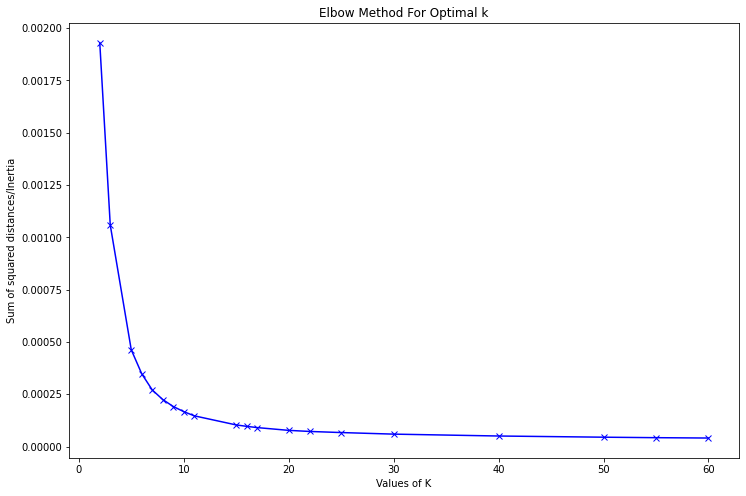

In [ ]:
Sum_of_squared_distances = []

K = [2, 3, 5, 6, 7, 8, 9, 10, 11, 15, 16 , 17, 20, 22, 25, 30, 40, 50, 55, 60]
for num_clusters in K :
  kmeans = KMeans(n_clusters=num_clusters, random_state = 0, max_iter=50)
  kmeans.fit_predict(X_normalized)
  Sum_of_squared_distances.append(kmeans.inertia_)

fig = plt.figure(figsize=(12,8))
plt.plot(K,Sum_of_squared_distances,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Sum of squared distances/Inertia') 
plt.title('Elbow Method For Optimal k')
plt.show()

In [ ]:
kmn = KMeans(n_clusters=10, random_state = 0).fit(X_normalized)
pca = PCA(n_components = 2)
X = pca.fit_transform(X_normalized)
y_pred = kmn.fit_predict(X_normalized)
label = kmn.labels_
# plt.scatter(X[:,0], X[:,1],c=y_pred, cmap='Paired')
# plt.title("kmeans")

Text(0.5, 1.0, 'kmeans')

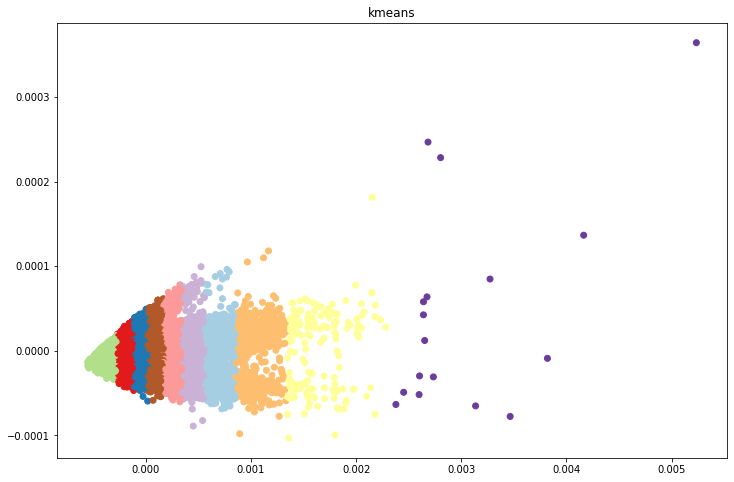

In [ ]:
fig = plt.figure(figsize=(12,8))
plt.scatter(X[:,0], X[:,1],c=y_pred, cmap='Paired')
plt.title("kmeans")

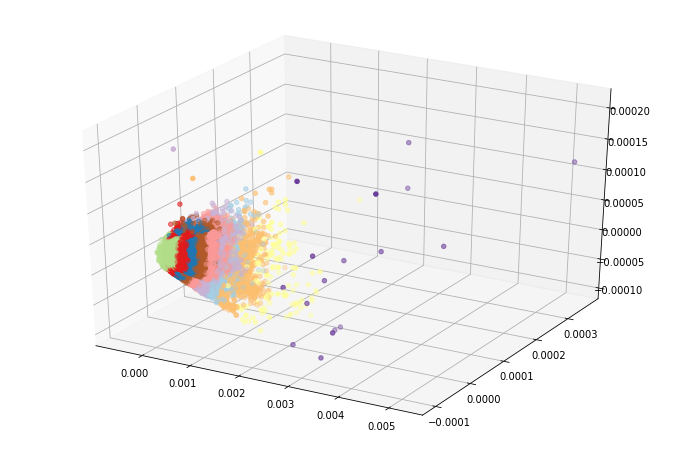

In [ ]:
fig = plt.figure(figsize=(12,8))
ax = plt.axes(projection='3d')

kmn = KMeans(n_clusters=10,random_state = 0).fit(X_normalized)
pca = PCA(n_components = 3)
X = pca.fit_transform(X_normalized)
y_pred = kmn.fit_predict(X_normalized)
label = kmn.labels_

ax.scatter3D(X[:,0],X[:,1],X[:,2], c=y_pred, cmap='Paired');
# plt.title("kmeans")

In [ ]:
tsne = TSNE()
X_embedded = tsne.fit_transform(X_normalized)

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


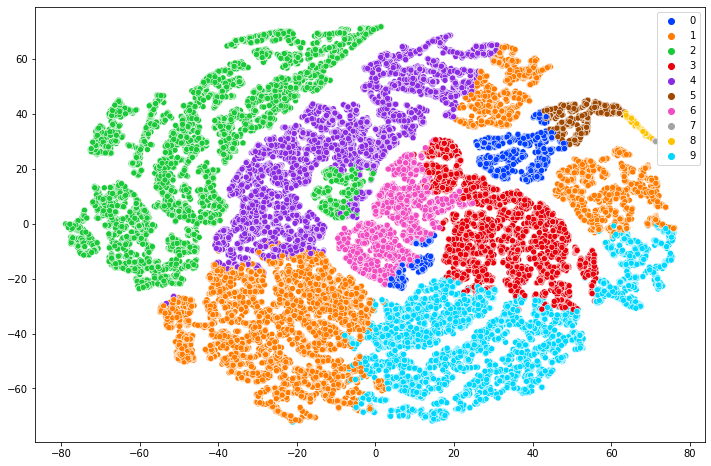

In [ ]:
palette = sns.color_palette("bright", 10)

fig = plt.figure(figsize=(12,8))
sns.scatterplot(X_embedded[:,0], X_embedded[:,1], hue=y_pred, legend='full', palette=palette)

In [ ]:
new_df['n_kmeans_label'] = label

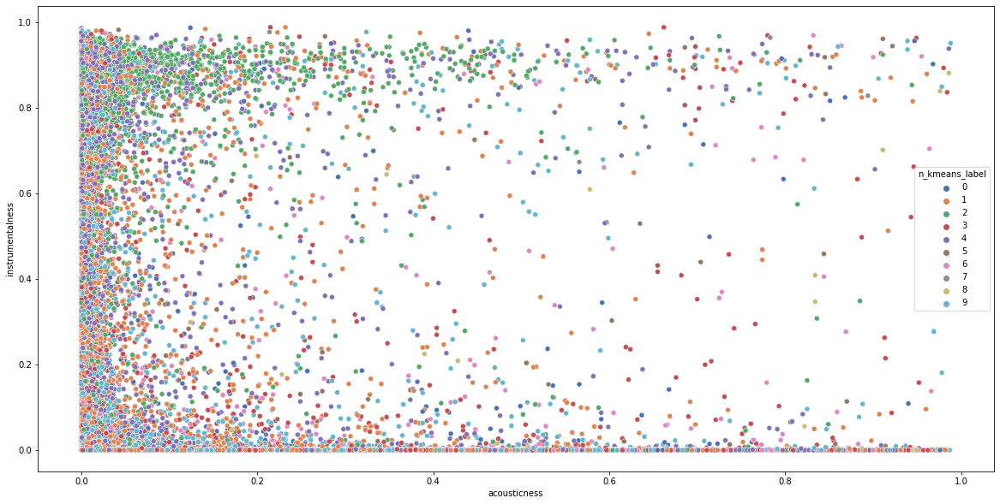

In [ ]:
plt.figure(figsize=(20,10))
sns.scatterplot(x = 'acousticness',y = 'instrumentalness', data = new_df, hue = 'n_kmeans_label',palette='deep')
plt.show()

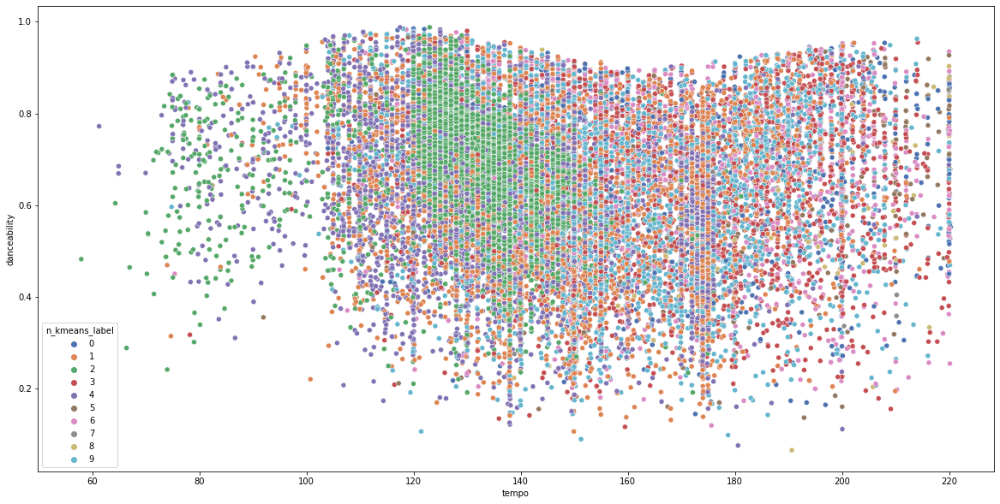

In [ ]:
plt.figure(figsize=(20,10))
sns.scatterplot(x = 'tempo',y = 'danceability', data = new_df, hue = 'n_kmeans_label',palette='deep')
plt.show()

In [ ]:
mask = new_df['n_kmeans_label'] == 4
new_df[mask].genre.value_counts()

8     1097
11     753
13     714
0      708
14     657
9      524
2      517
5      487
7      479
4      452
1      325
12     220
10     111
3      103
6       73
Name: genre, dtype: int64

In [ ]:
mask = new_df['n_kmeans_label'] == 5
new_df[mask].genre.value_counts()

7     243
0     196
6     186
2      37
5      17
4      10
1       4
13      2
9       2
14      1
11      1
8       1
3       1
Name: genre, dtype: int64

In [ ]:
df=pd.read_csv("/content/drive/MyDrive/spotify_data/spotify_dataframe.csv")

In [ ]:
new_df = df.drop(['type', 'id', 'uri', 'track_href','analysis_url', 'title','song_name'], axis=1)

In [ ]:
encoded_data = pd.get_dummies(new_df, columns = ['genre'])

In [ ]:
X_normalized = normalize(encoded_data)

X_normalized = pd.DataFrame(X_normalized,columns=encoded_data.columns)

In [ ]:
X_normalized

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,genre_Dark Trap,genre_Emo,genre_Hiphop,genre_Pop,genre_Rap,genre_RnB,genre_Trap Metal,genre_Underground Rap,genre_dnb,genre_hardstyle,genre_psytrance,genre_techhouse,genre_techno,genre_trance,genre_trap
0,0.000007,0.000007,0.000016,-0.000059,0.000008,3.372435e-06,4.801705e-07,1.075967e-07,4.464461e-07,3.123517e-06,0.001261,0.999999,0.000032,0.000008,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
1,0.000003,0.000002,0.000036,-0.000032,0.000004,3.537898e-07,1.786772e-06,0.000000e+00,5.257834e-07,5.525181e-07,0.000513,1.000000,0.000018,0.000004,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
2,0.000009,0.000009,0.000051,-0.000048,0.000010,6.304313e-07,1.396461e-07,4.189383e-11,3.764373e-06,3.956639e-07,0.002207,0.999998,0.000040,0.000010,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
3,0.000004,0.000006,0.000000,-0.000038,0.000008,8.329213e-07,1.916528e-07,0.000000e+00,9.218741e-07,1.415158e-06,0.001512,0.999999,0.000024,0.000008,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
4,0.000006,0.000005,0.000016,-0.000062,0.000008,2.376355e-06,1.759962e-06,0.000000e+00,1.346331e-06,4.793262e-06,0.001200,0.999999,0.000032,0.000008,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42300,0.000002,0.000003,0.000015,-0.000019,0.000004,1.129238e-07,1.170099e-07,1.281537e-09,4.494665e-07,1.463552e-06,0.000557,1.000000,0.000015,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000004,0.0,0.0,0.0,0.0,0.0
42301,0.000002,0.000004,0.000000,-0.000038,0.000000,2.279736e-07,1.070857e-07,8.662045e-11,9.756699e-07,1.822837e-06,0.000714,1.000000,0.000019,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000005,0.0,0.0,0.0,0.0,0.0
42302,0.000002,0.000003,0.000034,-0.000013,0.000004,2.150555e-07,1.107217e-07,1.030563e-09,1.639532e-06,5.280572e-07,0.000660,1.000000,0.000017,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000004,0.0,0.0,0.0,0.0,0.0
42303,0.000001,0.000003,0.000019,-0.000015,0.000000,1.212871e-07,1.704827e-09,9.158415e-08,1.779084e-07,1.509901e-06,0.000464,1.000000,0.000012,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000003,0.0,0.0,0.0,0.0,0.0


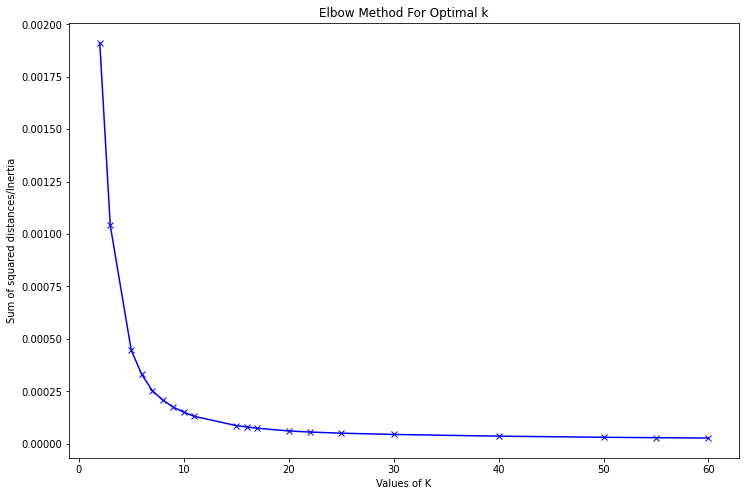

In [ ]:
Sum_of_squared_distances = []

K = [2, 3, 5, 6, 7, 8, 9, 10, 11, 15, 16 , 17, 20, 22, 25, 30, 40, 50, 55, 60]
for num_clusters in K :
  kmeans = KMeans(n_clusters=num_clusters, random_state = 0, max_iter=50)
  kmeans.fit_predict(X_normalized)
  Sum_of_squared_distances.append(kmeans.inertia_)

fig = plt.figure(figsize=(12,8))
plt.plot(K,Sum_of_squared_distances,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Sum of squared distances/Inertia') 
plt.title('Elbow Method For Optimal k')
plt.show()

In [ ]:
kmn = KMeans(n_clusters=11, random_state = 0).fit(X_normalized)
pca = PCA(n_components = 2)
X = pca.fit_transform(X_normalized)
y_pred = kmn.fit_predict(X_normalized)
label = kmn.labels_
# plt.scatter(X[:,0], X[:,1],c=y_pred, cmap='Paired')
# plt.title("kmeans")

Text(0.5, 1.0, 'kmeans')

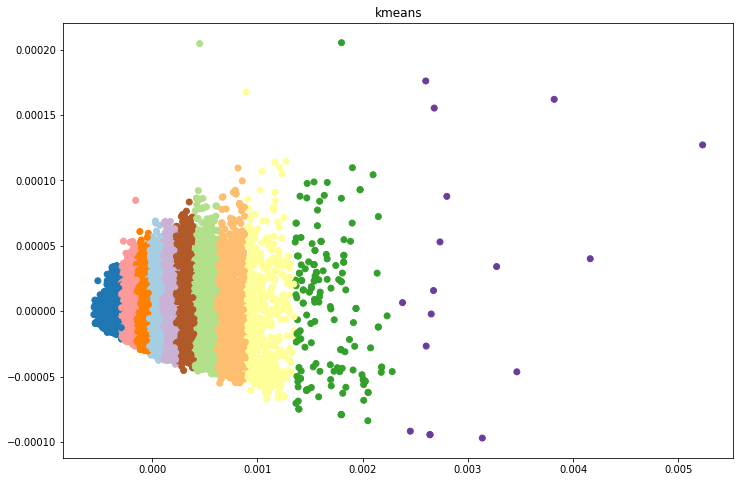

In [ ]:
fig = plt.figure(figsize=(12,8))
plt.scatter(X[:,0], X[:,1],c=y_pred, cmap='Paired')
plt.title("kmeans")

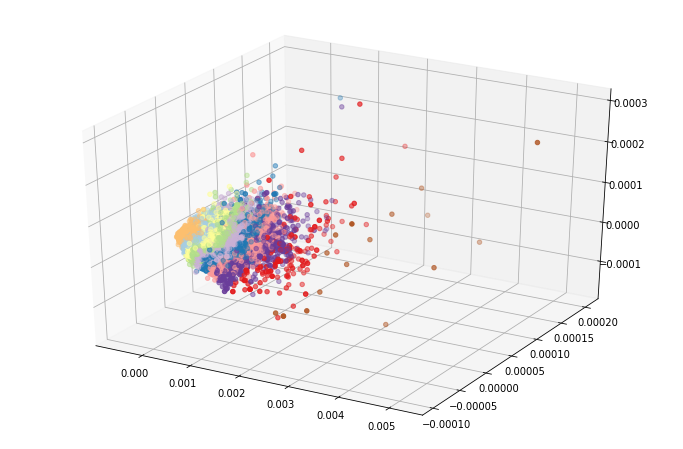

In [ ]:
fig = plt.figure(figsize=(12,8))
ax = plt.axes(projection='3d')

kmn = KMeans(n_clusters=10,random_state = 0).fit(X_normalized)
pca = PCA(n_components = 3)
X = pca.fit_transform(X_normalized)
y_pred = kmn.fit_predict(X_normalized)
label = kmn.labels_

ax.scatter3D(X[:,0],X[:,1],X[:,2], c=y_pred, cmap='Paired');
# plt.title("kmeans")

In [ ]:
from sklearn.manifold import TSNE

tsne = TSNE()
X_embedded = tsne.fit_transform(X_normalized)

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


In [ ]:
palette = sns.color_palette("bright", 10)

fig = plt.figure(figsize=(12,8))
sns.scatterplot(X_embedded[:,0], X_embedded[:,1], hue=y_pred, legend='full', palette=palette)

In [ ]:
new_df['n_kmeans_label'] = label

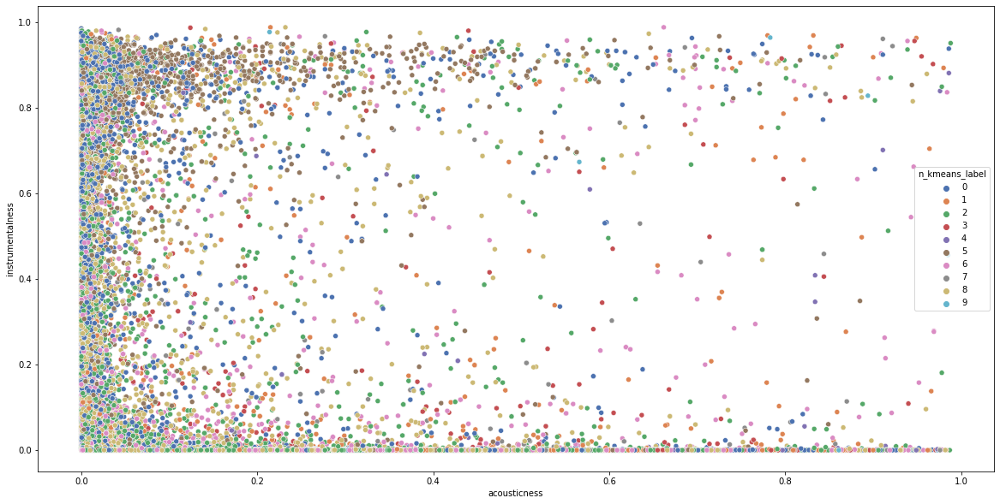

In [ ]:
plt.figure(figsize=(20,10))
sns.scatterplot(x = 'acousticness',y = 'instrumentalness', data = new_df, hue = 'n_kmeans_label',palette='deep')
plt.show()

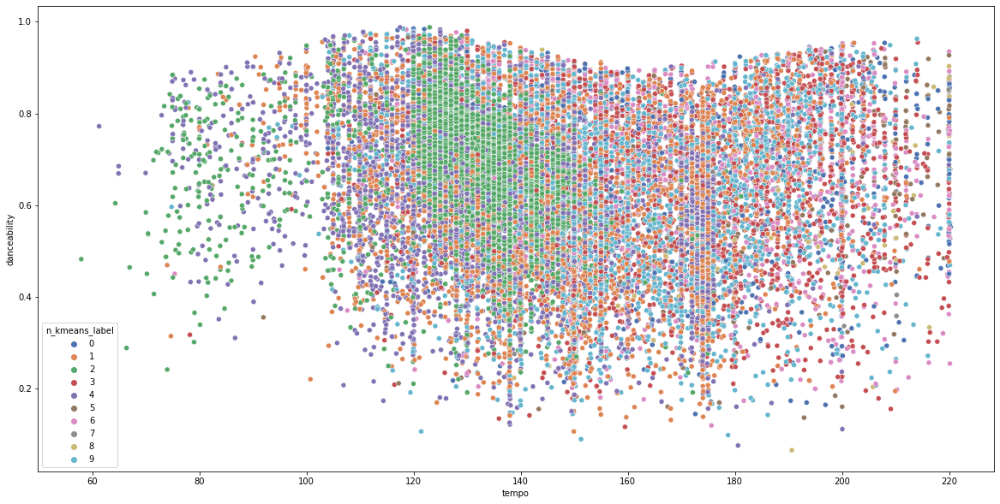

In [ ]:
plt.figure(figsize=(20,10))
sns.scatterplot(x = 'tempo',y = 'danceability', data = new_df, hue = 'n_kmeans_label',palette='deep')
plt.show()

In [ ]:
mask = new_df['n_kmeans_label'] == 4
new_df[mask].genre.value_counts()

Trap Metal         61
Dark Trap          50
Underground Rap    48
Hiphop             19
RnB                 2
dnb                 2
Rap                 1
trance              1
Name: genre, dtype: int64

In [ ]:
mask = new_df['n_kmeans_label'] == 4
new_df[mask].genre.value_counts()

Trap Metal         61
Dark Trap          50
Underground Rap    48
Hiphop             19
RnB                 2
dnb                 2
Rap                 1
trance              1
Name: genre, dtype: int64

# without using genre

In [112]:
df=pd.read_csv("/content/drive/MyDrive/spotify_data/spotify_dataframe.csv")
new_df = df.drop(['type', 'id', 'uri', 'track_href','analysis_url', 'title','song_name','genre'], axis=1)

In [113]:
new_df

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,0.831,0.814,2,-7.364,1,0.4200,0.059800,0.013400,0.0556,0.3890,156.985,124539,4
1,0.719,0.493,8,-7.230,1,0.0794,0.401000,0.000000,0.1180,0.1240,115.080,224427,4
2,0.850,0.893,5,-4.783,1,0.0623,0.013800,0.000004,0.3720,0.0391,218.050,98821,4
3,0.476,0.781,0,-4.710,1,0.1030,0.023700,0.000000,0.1140,0.1750,186.948,123661,3
4,0.798,0.624,2,-7.668,1,0.2930,0.217000,0.000000,0.1660,0.5910,147.988,123298,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
42300,0.528,0.693,4,-5.148,1,0.0304,0.031500,0.000345,0.1210,0.3940,150.013,269208,4
42301,0.517,0.768,0,-7.922,0,0.0479,0.022500,0.000018,0.2050,0.3830,149.928,210112,4
42302,0.361,0.821,8,-3.102,1,0.0505,0.026000,0.000242,0.3850,0.1240,154.935,234823,4
42303,0.477,0.921,6,-4.777,0,0.0392,0.000551,0.029600,0.0575,0.4880,150.042,323200,4


In [114]:
new_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42305 entries, 0 to 42304
Data columns (total 13 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   danceability      42305 non-null  float64
 1   energy            42305 non-null  float64
 2   key               42305 non-null  int64  
 3   loudness          42305 non-null  float64
 4   mode              42305 non-null  int64  
 5   speechiness       42305 non-null  float64
 6   acousticness      42305 non-null  float64
 7   instrumentalness  42305 non-null  float64
 8   liveness          42305 non-null  float64
 9   valence           42305 non-null  float64
 10  tempo             42305 non-null  float64
 11  duration_ms       42305 non-null  int64  
 12  time_signature    42305 non-null  int64  
dtypes: float64(9), int64(4)
memory usage: 4.2 MB


In [115]:
scaler = MinMaxScaler()
X_scaled = scaler.fit_transform(new_df)

X_scaled = pd.DataFrame(X_scaled,columns=new_df.columns)

In [18]:
# X_normalized = normalize(new_df[['energy','speechiness','acousticness','instrumentalness','liveness']])

# X_normalized = pd.DataFrame(X_normalized,columns=['energy','speechiness','acousticness','instrumentalness','liveness'])

In [37]:
X_scaled

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,0.829884,0.813955,0.181818,0.712039,1.0,0.430304,0.060525,0.013549,0.045943,0.382028,0.610006,0.111487,0.75
1,0.708527,0.492877,0.727273,0.715710,1.0,0.061410,0.405870,0.000000,0.109792,0.108635,0.351848,0.224043,0.75
2,0.850471,0.892974,0.454545,0.782742,1.0,0.042890,0.013967,0.000004,0.369692,0.021046,0.986200,0.082507,0.75
3,0.445227,0.780947,0.000000,0.784742,1.0,0.086971,0.023987,0.000000,0.105699,0.161250,0.794595,0.110497,0.50
4,0.794127,0.623909,0.181818,0.703712,1.0,0.292754,0.219635,0.000000,0.158907,0.590426,0.554579,0.110088,0.75
...,...,...,...,...,...,...,...,...,...,...,...,...,...
42300,0.501571,0.692925,0.363636,0.772743,1.0,0.008340,0.031882,0.000349,0.112862,0.387187,0.567055,0.274503,0.75
42301,0.489652,0.767944,0.000000,0.696754,0.0,0.027293,0.022772,0.000018,0.198813,0.375838,0.566531,0.207912,0.75
42302,0.320620,0.820956,0.727273,0.828791,1.0,0.030109,0.026315,0.000245,0.382994,0.108635,0.597377,0.235757,0.75
42303,0.446311,0.920981,0.545455,0.782906,0.0,0.017871,0.000557,0.029929,0.047887,0.484164,0.567233,0.335342,0.75


## Kmeans

In [ ]:
range_n_clusters = [2, 3, 5, 6, 7, 8, 9, 10, 11, 15, 16 , 17, 20, 22, 25, 30, 40, 50, 55, 60]
for n_clusters in range_n_clusters:
  clusterer = KMeans(n_clusters=n_clusters, random_state=10)
  cluster_labels = clusterer.fit_predict(X_scaled)

  silhouette_avg = silhouette_score(X_scaled, cluster_labels)
  print("for n_clusters =", n_clusters, "The average silhouette_score is :", silhouette_avg)

for n_clusters = 2 The average silhouette_score is : 0.14872283129213248
for n_clusters = 3 The average silhouette_score is : 0.13628551776381517
for n_clusters = 5 The average silhouette_score is : 0.13763542025817968
for n_clusters = 6 The average silhouette_score is : 0.125554381574174
for n_clusters = 7 The average silhouette_score is : 0.1300421198598314
for n_clusters = 8 The average silhouette_score is : 0.1213796414733788
for n_clusters = 9 The average silhouette_score is : 0.12127477146767036
for n_clusters = 10 The average silhouette_score is : 0.11213572905732014
for n_clusters = 11 The average silhouette_score is : 0.11311803347803989
for n_clusters = 15 The average silhouette_score is : 0.11859360179297485
for n_clusters = 16 The average silhouette_score is : 0.1159811539614684
for n_clusters = 17 The average silhouette_score is : 0.11499325994936667
for n_clusters = 20 The average silhouette_score is : 0.11493955817561592
for n_clusters = 22 The average silhouette_score i

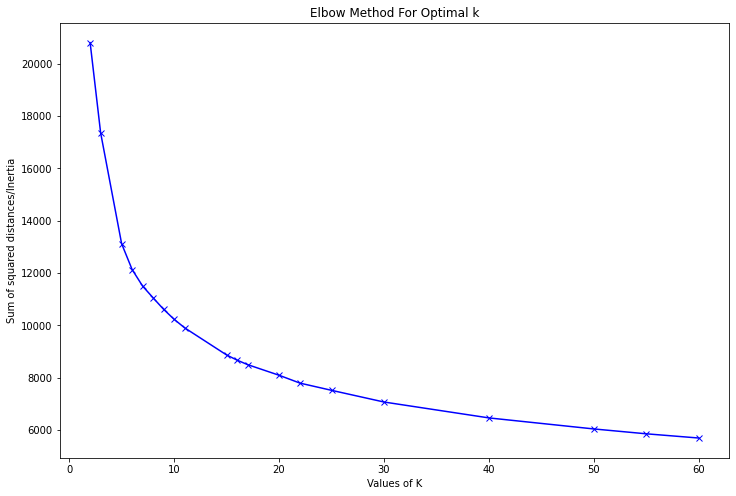

In [117]:
Sum_of_squared_distances = []
K = [2, 3, 5, 6, 7, 8, 9, 10, 11, 15, 16 , 17, 20, 22, 25, 30, 40, 50, 55, 60]
for num_clusters in K :
  kmeans = KMeans(n_clusters=num_clusters, max_iter=50)
  kmeans.fit_predict(X_scaled)
  Sum_of_squared_distances.append(kmeans.inertia_)

fig = plt.figure(figsize=(12,8))
plt.plot(K,Sum_of_squared_distances,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Sum of squared distances/Inertia') 
plt.title('Elbow Method For Optimal k')
plt.show()

Text(0.5, 1.0, 'kmeans')

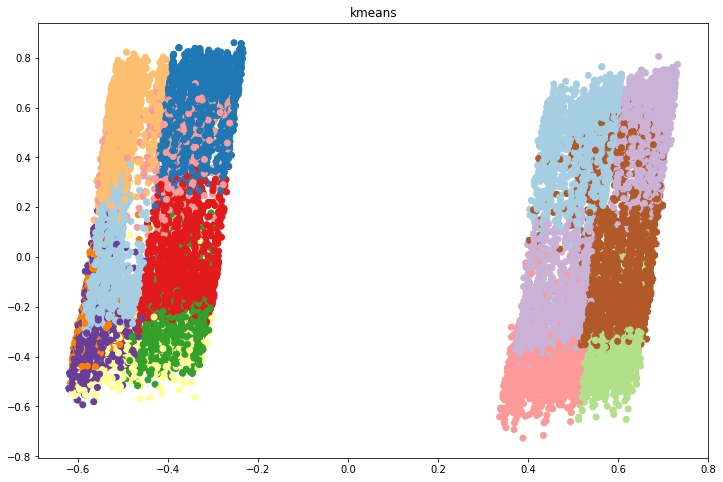

In [119]:
kmn = KMeans(n_clusters=16, random_state = 0).fit(X_scaled)

pca = PCA(n_components = 2)
X = pca.fit_transform(X_scaled)
y_pred = kmn.fit_predict(X_scaled)
label = kmn.labels_

fig = plt.figure(figsize=(12,8))
plt.scatter(X[:,0], X[:,1],c=y_pred, cmap='Paired')
plt.title("kmeans")

In [71]:
import pickle
pickle.dump(kmn, open("model.pkl", "wb"))

In [75]:
df['kmn_label'] = label

In [78]:
df.to_csv (r'/content/drive/MyDrive/spotify_data/spotify_dataframe.csv', index = False, header=True)

In [120]:
from sklearn.manifold import TSNE

tsne = TSNE()
X_embedded = tsne.fit_transform(X_scaled)

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


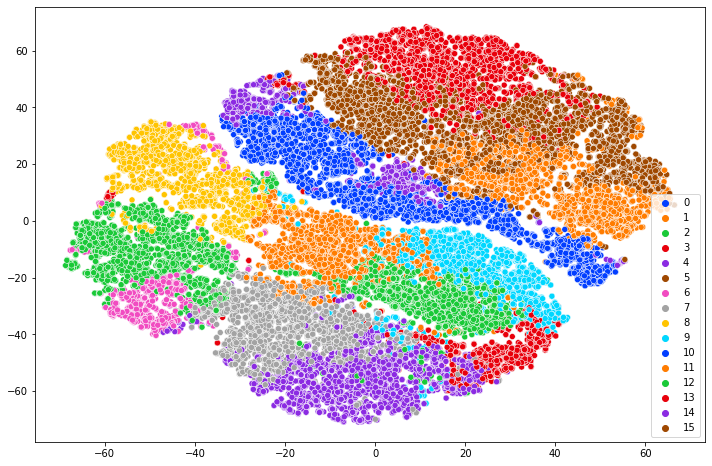

In [121]:
palette = sns.color_palette("bright", 16)

fig = plt.figure(figsize=(12,8))
sns.scatterplot(X_embedded[:,0], X_embedded[:,1], hue=y_pred, legend='full', palette=palette)

In [43]:
# fig = plt.figure(figsize=(12,8))
# ax = plt.axes(projection='3d')


# pca = PCA(n_components = 3)
# X = pca.fit_transform(X_scaled)
# label = kmn.labels_

# ax.scatter3D(X[:,2],X[:,1],X[:,0], c=y_pred, cmap='Paired');
# # plt.title("kmeans")

In [48]:
df['kmn_label'] = label

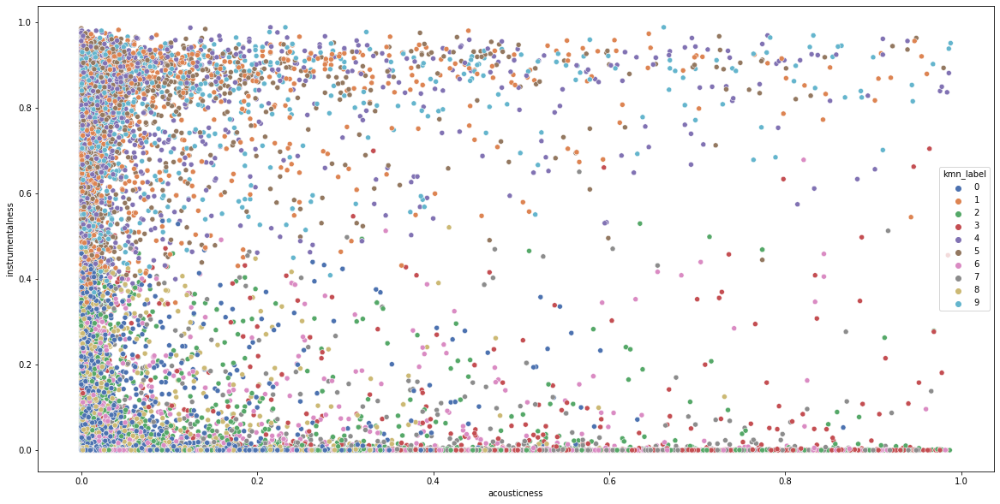

In [49]:
plt.figure(figsize=(20,10))
sns.scatterplot(x = 'acousticness',y = 'instrumentalness', data = df, hue = 'kmn_label',palette='deep')
plt.show()

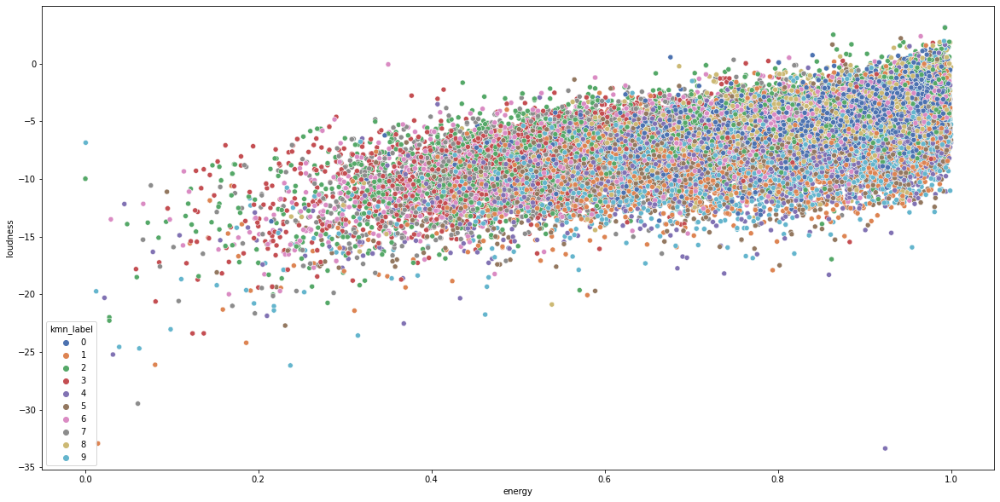

In [50]:
plt.figure(figsize=(20,10))
sns.scatterplot(x = 'energy',y = 'loudness', data = df, hue = 'kmn_label',palette='deep')
plt.show()

In [52]:
mask = df['kmn_label'] == 4
df[mask]

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,type,id,uri,track_href,analysis_url,duration_ms,time_signature,genre,song_name,title,kmn_label
33,0.455,0.525,5,-12.692,0,0.0455,0.13600,0.734,0.1250,0.2790,119.999,audio_features,2Tu4kHEeIVFn6Re2ybm2lQ,spotify:track:2Tu4kHEeIVFn6Re2ybm2lQ,https://api.spotify.com/v1/tracks/2Tu4kHEeIVFn...,https://api.spotify.com/v1/audio-analysis/2Tu4...,159974,4,Dark Trap,OhNo!,NaN,4
97,0.713,0.839,4,-6.377,0,0.3490,0.00417,0.706,0.1060,0.0369,150.004,audio_features,0FP2R9giDksk3a1GUQLfOz,spotify:track:0FP2R9giDksk3a1GUQLfOz,https://api.spotify.com/v1/tracks/0FP2R9giDksk...,https://api.spotify.com/v1/audio-analysis/0FP2...,149230,4,Dark Trap,As Above so Look out Below,NaN,4
347,0.545,0.631,0,-9.781,0,0.3930,0.06580,0.611,0.2150,0.2170,146.966,audio_features,5VFbdZNEGg23mxBCflVErr,spotify:track:5VFbdZNEGg23mxBCflVErr,https://api.spotify.com/v1/tracks/5VFbdZNEGg23...,https://api.spotify.com/v1/audio-analysis/5VFb...,137270,4,Dark Trap,Polo Socks,NaN,4
641,0.606,0.316,4,-12.638,0,0.0716,0.69300,0.668,0.1080,0.0580,125.893,audio_features,4yaA0P1V4jUSdaorFrqyPS,spotify:track:4yaA0P1V4jUSdaorFrqyPS,https://api.spotify.com/v1/tracks/4yaA0P1V4jUS...,https://api.spotify.com/v1/audio-analysis/4yaA...,154000,4,Dark Trap,Far Cry,NaN,4
835,0.700,0.507,4,-12.383,0,0.0650,0.08290,0.594,0.2620,0.2430,156.031,audio_features,0hmlUYT2lmy1RfTcejgwvX,spotify:track:0hmlUYT2lmy1RfTcejgwvX,https://api.spotify.com/v1/tracks/0hmlUYT2lmy1...,https://api.spotify.com/v1/audio-analysis/0hml...,239903,4,Dark Trap,Miss Me,NaN,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42203,0.468,0.894,1,-4.529,0,0.0329,0.00258,0.946,0.3330,0.2870,149.963,audio_features,7KtHOE5kGITw6cNV4SxRTz,spotify:track:7KtHOE5kGITw6cNV4SxRTz,https://api.spotify.com/v1/tracks/7KtHOE5kGITw...,https://api.spotify.com/v1/audio-analysis/7KtH...,206400,4,hardstyle,The Rhythm,Euphoric Hardstyle,4
42227,0.583,0.899,5,-3.438,0,0.0622,0.00877,0.524,0.0853,0.5160,147.983,audio_features,40NwPbZAm66RF64qi3RixE,spotify:track:40NwPbZAm66RF64qi3RixE,https://api.spotify.com/v1/tracks/40NwPbZAm66R...,https://api.spotify.com/v1/audio-analysis/40Nw...,267600,4,hardstyle,Airwave - Original Mix,Euphoric Hardstyle & Melodic Hardstyle,4
42232,0.538,0.859,7,-8.236,0,0.0381,0.03100,0.443,0.0961,0.2760,154.998,audio_features,09NjhfSj1igDi8pDri23DM,spotify:track:09NjhfSj1igDi8pDri23DM,https://api.spotify.com/v1/tracks/09NjhfSj1igD...,https://api.spotify.com/v1/audio-analysis/09Nj...,393950,4,hardstyle,Resistance,Euphoric Hardstyle,4
42266,0.547,0.863,5,-5.804,0,0.0501,0.00436,0.452,0.0871,0.4110,149.964,audio_features,6lJjwLizvkLEyGaQyfgSoD,spotify:track:6lJjwLizvkLEyGaQyfgSoD,https://api.spotify.com/v1/tracks/6lJjwLizvkLE...,https://api.spotify.com/v1/audio-analysis/6lJj...,334429,4,hardstyle,Far From Reality - Original Mix,Euphoric Hardstyle,4


In [53]:
df[mask].genre.value_counts()

psytrance          634
techno             604
trance             515
dnb                466
Dark Trap          416
techhouse          391
hardstyle          139
trap               132
Trap Metal          23
Underground Rap     15
Hiphop              13
RnB                  7
Emo                  4
Rap                  2
Name: genre, dtype: int64

In [ ]:
# cluster_map = pd.DataFrame()
# cluster_map['data_index'] = new_df.index.values
# cluster_map['cluster_db'] = db_label
# cluster_map['genre']=new_df.genre
# cluster_map

In [133]:
df=pd.read_csv("/content/drive/MyDrive/spotify_data/spotify_dataframe.csv")
new_df = df.drop(['type', 'id', 'uri', 'track_href','analysis_url', 'title','song_name','genre'], axis=1)

In [134]:
##Normal
X_normalized = normalize(new_df)

X_normalized = pd.DataFrame(X_normalized,columns=new_df.columns)

In [135]:
X_normalized

,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,0.000007,0.000007,0.000016,-0.000059,0.000008,3.372435e-06,4.801705e-07,1.075967e-07,4.464461e-07,3.123517e-06,0.001261,0.999999,0.000032
1,0.000003,0.000002,0.000036,-0.000032,0.000004,3.537898e-07,1.786772e-06,0.000000e+00,5.257834e-07,5.525181e-07,0.000513,1.000000,0.000018
2,0.000009,0.000009,0.000051,-0.000048,0.000010,6.304313e-07,1.396461e-07,4.189383e-11,3.764373e-06,3.956639e-07,0.002207,0.999998,0.000040
3,0.000004,0.000006,0.000000,-0.000038,0.000008,8.329213e-07,1.916528e-07,0.000000e+00,9.218741e-07,1.415158e-06,0.001512,0.999999,0.000024
4,0.000006,0.000005,0.000016,-0.000062,0.000008,2.376355e-06,1.759962e-06,0.000000e+00,1.346331e-06,4.793262e-06,0.001200,0.999999,0.000032
...,...,...,...,...,...,...,...,...,...,...,...,...,...
42300,0.000002,0.000003,0.000015,-0.000019,0.000004,1.129238e-07,1.170099e-07,1.281537e-09,4.494665e-07,1.463552e-06,0.000557,1.000000,0.000015
42301,0.000002,0.000004,0.000000,-0.000038,0.000000,2.279736e-07,1.070857e-07,8.662045e-11,9.756699e-07,1.822837e-06,0.000714,1.000000,0.000019
42302,0.000002,0.000003,0.000034,-0.000013,0.000004,2.150555e-07,1.107217e-07,1.030563e-09,1.639532e-06,5.280572e-07,0.000660,1.000000,0.000017
42303,0.000001,0.000003,0.000019,-0.000015,0.000000,1.212871e-07,1.704827e-09,9.158415e-08,1.779084e-07,1.509901e-06,0.000464,1.000000,0.000012


In [ ]:
# range_n_clusters = [2, 3, 5, 6, 7, 8, 9, 10, 11, 15, 16 , 17, 20, 22, 25, 30, 40, 50, 55, 60]
# for n_clusters in range_n_clusters:
#   clusterer = KMeans(n_clusters=n_clusters, random_state=10)
#   cluster_labels = clusterer.fit_predict(X_scaled)

#   silhouette_avg = silhouette_score(X_scaled, cluster_labels)
#   print("for n_clusters =", n_clusters, "The average silhouette_score is :", silhouette_avg)

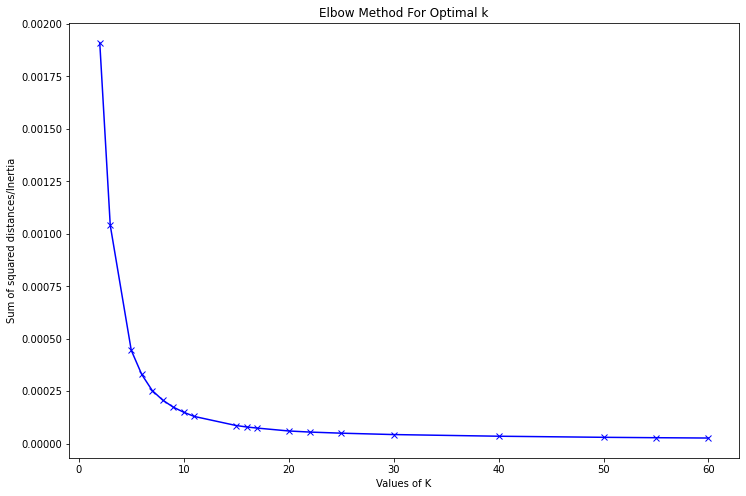

In [ ]:
Sum_of_squared_distances = []
K = [2, 3, 5, 6, 7, 8, 9, 10, 11, 15, 16 , 17, 20, 22, 25, 30, 40, 50, 55, 60]
for num_clusters in K :
  kmeans = KMeans(n_clusters=num_clusters, max_iter=50)
  kmeans.fit_predict(X_normalized)
  Sum_of_squared_distances.append(kmeans.inertia_)

fig = plt.figure(figsize=(12,8))
plt.plot(K,Sum_of_squared_distances,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Sum of squared distances/Inertia') 
plt.title('Elbow Method For Optimal k')
plt.show()

Text(0.5, 1.0, 'kmeans')

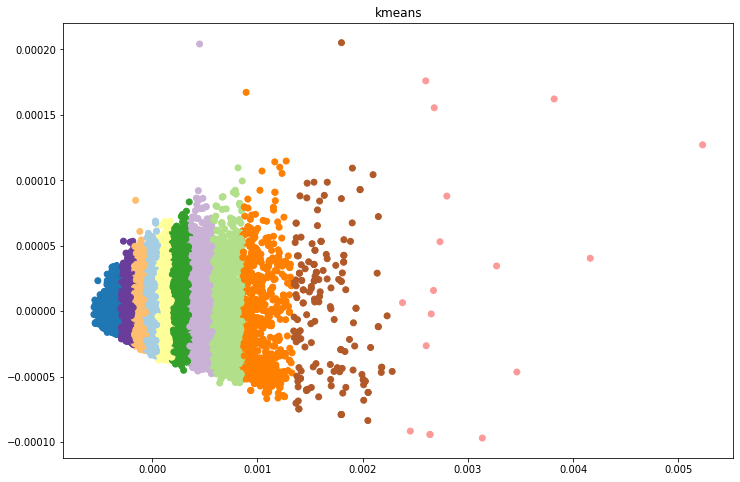

In [136]:
kmn = KMeans(n_clusters=11, random_state = 0).fit(X_normalized)

pca = PCA(n_components = 2)
X = pca.fit_transform(X_normalized)
y_pred = kmn.fit_predict(X_normalized)
label = kmn.labels_

fig = plt.figure(figsize=(12,8))
plt.scatter(X[:,0], X[:,1],c=y_pred, cmap='Paired')
plt.title("kmeans")

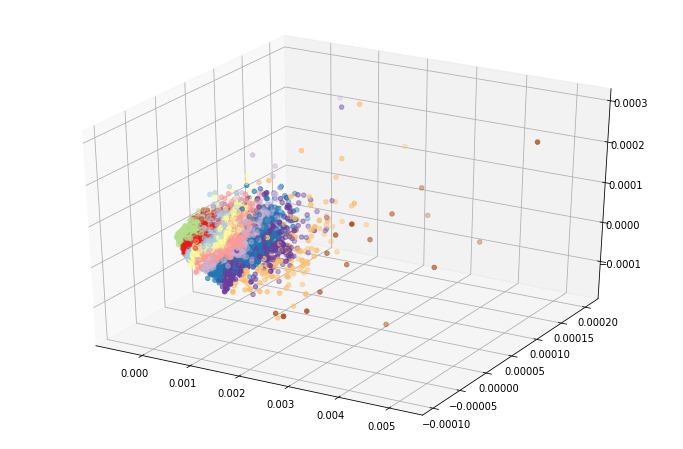

In [ ]:
fig = plt.figure(figsize=(12,8))
ax = plt.axes(projection='3d')


pca = PCA(n_components = 3)
X = pca.fit_transform(X_normalized)
label = kmn.labels_

ax.scatter3D(X[:,0],X[:,1],X[:,2], c=y_pred, cmap='Paired');
# plt.title("kmeans")

In [126]:
tsne = TSNE()
X_embedded = tsne.fit_transform(X_normalized)

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


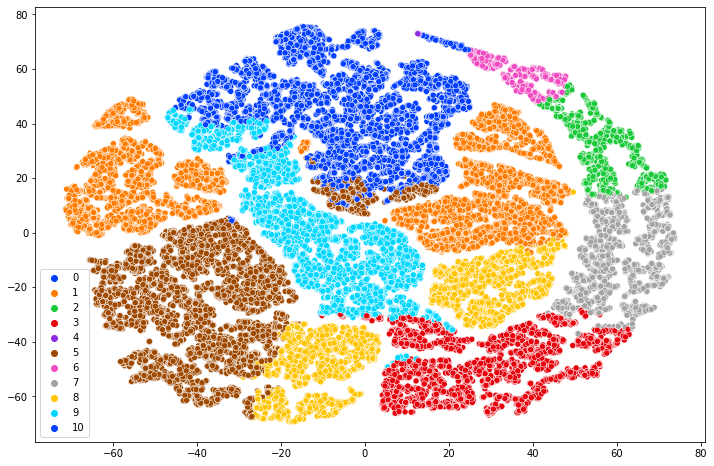

In [127]:
palette = sns.color_palette("bright", 11)

fig = plt.figure(figsize=(12,8))
sns.scatterplot(X_embedded[:,0], X_embedded[:,1], hue=y_pred, legend='full', palette=palette)

In [137]:
import pickle
pickle.dump(kmn, open("model.pkl", "wb"))

In [138]:
df['kmn_label'] = label

In [139]:
df.to_csv(r'/content/data.csv', index = False, header=True)

In [128]:
df=pd.read_csv("/content/drive/MyDrive/spotify_data/spotify_dataframe.csv")
new_df = df.drop(['type', 'id', 'uri', 'track_href','analysis_url', 'title','song_name','genre'], axis=1)

In [129]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(new_df)

X_scaled = pd.DataFrame(X_scaled,columns=new_df.columns)

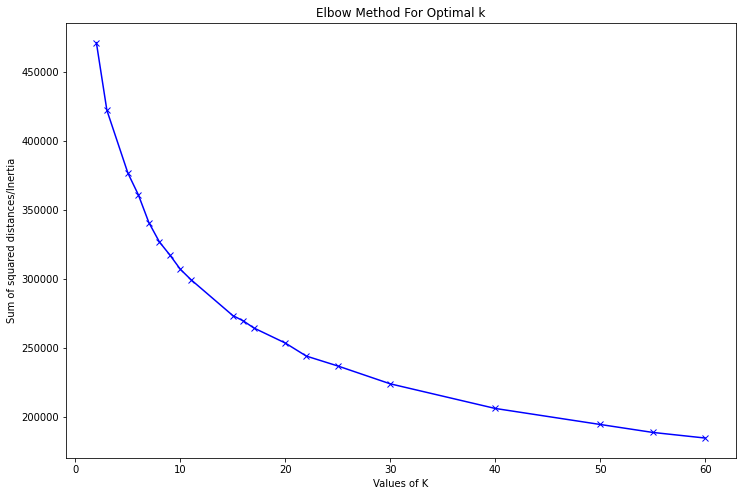

In [63]:
Sum_of_squared_distances = []
K = [2, 3, 5, 6, 7, 8, 9, 10, 11, 15, 16 , 17, 20, 22, 25, 30, 40, 50, 55, 60]
for num_clusters in K :
  kmeans = KMeans(n_clusters=num_clusters, max_iter=50)
  kmeans.fit_predict(X_scaled)
  Sum_of_squared_distances.append(kmeans.inertia_)

fig = plt.figure(figsize=(12,8))
plt.plot(K,Sum_of_squared_distances,'bx-')
plt.xlabel('Values of K') 
plt.ylabel('Sum of squared distances/Inertia') 
plt.title('Elbow Method For Optimal k')
plt.show()

Text(0.5, 1.0, 'kmeans')

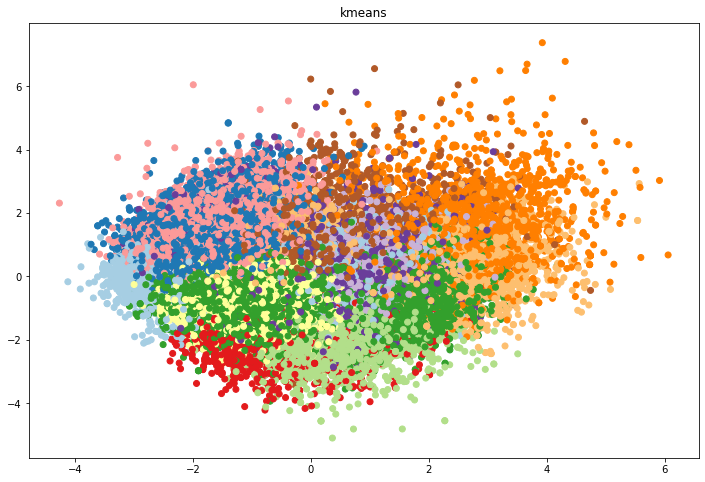

In [130]:
kmn = KMeans(n_clusters=17, random_state = 0).fit(X_scaled)

pca = PCA(n_components = 2)
X = pca.fit_transform(X_scaled)
y_pred = kmn.fit_predict(X_scaled)
label = kmn.labels_

fig = plt.figure(figsize=(12,8))
plt.scatter(X[:,0], X[:,1],c=y_pred, cmap='Paired')
plt.title("kmeans")

In [131]:
tsne = TSNE()
X_embedded = tsne.fit_transform(X_scaled)

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


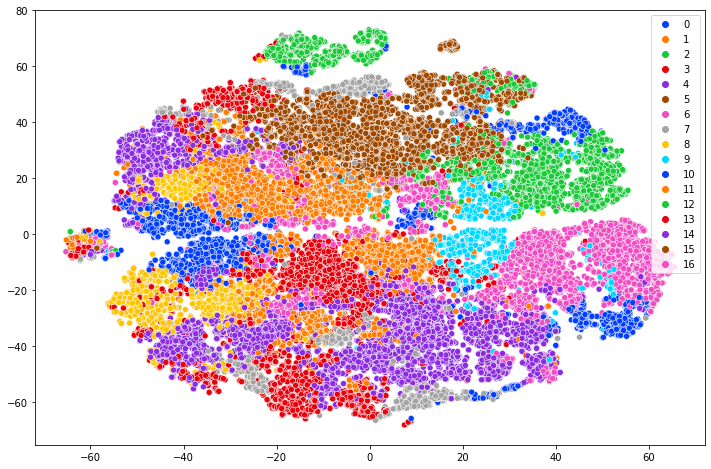

In [132]:
palette = sns.color_palette("bright", 17)

fig = plt.figure(figsize=(12,8))
sns.scatterplot(X_embedded[:,0], X_embedded[:,1], hue=y_pred, legend='full', palette=palette)

In [109]:
import pickle
pickle.dump(kmn, open("model.pkl", "wb"))

In [110]:
df['kmn_label'] = label

In [111]:
df.to_csv(r'/content/data.csv', index = False, header=True)